In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from matplotlib import pyplot as plt
import warnings
warnings.filterwarnings('ignore')
path = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/"
image_path = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/MSCOCO-Val-500/MSCOCO_500_Val/"

#Method 1: Question Generation From Images

##Relation Extraction

In [ ]:
!git clone https://github.com/yrcong/RelTR.git
%cd RelTR/
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as T

from PIL import Image
import requests
import matplotlib.pyplot as plt

Cloning into 'RelTR'...
remote: Enumerating objects: 317, done.
remote: Counting objects: 100% (317/317), done.
remote: Compressing objects: 100% (175/175), done.
remote: Total 317 (delta 140), reused 282 (delta 120), pack-reused 0
Receiving objects: 100% (317/317), 27.49 MiB | 29.88 MiB/s, done.
Resolving deltas: 100% (140/140), done.
/content/RelTR


###VG labels
VG 150 enitiy classes and 50 relationship classes.

In [ ]:
CLASSES = [ 'N/A', 'airplane', 'animal', 'arm', 'bag', 'banana', 'basket', 'beach', 'bear', 'bed', 'bench', 'bike',
                'bird', 'board', 'boat', 'book', 'boot', 'bottle', 'bowl', 'box', 'boy', 'branch', 'building',
                'bus', 'cabinet', 'cap', 'car', 'cat', 'chair', 'child', 'clock', 'coat', 'counter', 'cow', 'cup',
                'curtain', 'desk', 'dog', 'door', 'drawer', 'ear', 'elephant', 'engine', 'eye', 'face', 'fence',
                'finger', 'flag', 'flower', 'food', 'fork', 'fruit', 'giraffe', 'girl', 'glass', 'glove', 'guy',
                'hair', 'hand', 'handle', 'hat', 'head', 'helmet', 'hill', 'horse', 'house', 'jacket', 'jean',
                'kid', 'kite', 'lady', 'lamp', 'laptop', 'leaf', 'leg', 'letter', 'light', 'logo', 'man', 'men',
                'motorcycle', 'mountain', 'mouth', 'neck', 'nose', 'number', 'orange', 'pant', 'paper', 'paw',
                'people', 'person', 'phone', 'pillow', 'pizza', 'plane', 'plant', 'plate', 'player', 'pole', 'post',
                'pot', 'racket', 'railing', 'rock', 'roof', 'room', 'screen', 'seat', 'sheep', 'shelf', 'shirt',
                'shoe', 'short', 'sidewalk', 'sign', 'sink', 'skateboard', 'ski', 'skier', 'sneaker', 'snow',
                'sock', 'stand', 'street', 'surfboard', 'table', 'tail', 'tie', 'tile', 'tire', 'toilet', 'towel',
                'tower', 'track', 'train', 'tree', 'truck', 'trunk', 'umbrella', 'vase', 'vegetable', 'vehicle',
                'wave', 'wheel', 'window', 'windshield', 'wing', 'wire', 'woman', 'zebra']

REL_CLASSES = ['__background__', 'above', 'across', 'against', 'along', 'and', 'at', 'attached to', 'behind',
                'belonging to', 'between', 'carrying', 'covered in', 'covering', 'eating', 'flying in', 'for',
                'from', 'growing on', 'hanging from', 'has', 'holding', 'in', 'in front of', 'laying on',
                'looking at', 'lying on', 'made of', 'mounted on', 'near', 'of', 'on', 'on back of', 'over',
                'painted on', 'parked on', 'part of', 'playing', 'riding', 'says', 'sitting on', 'standing on',
                'to', 'under', 'using', 'walking in', 'walking on', 'watching', 'wearing', 'wears', 'with']


### Build and load the pretrained model

In [ ]:
from models.backbone import Backbone, Joiner
from models.position_encoding import PositionEmbeddingSine
from models.transformer import Transformer
from models.reltr import RelTR

position_embedding = PositionEmbeddingSine(128, normalize=True)
backbone = Backbone('resnet50', False, False, False)
backbone = Joiner(backbone, position_embedding)
backbone.num_channels = 2048

transformer = Transformer(d_model=256, dropout=0.1, nhead=8,
                          dim_feedforward=2048,
                          num_encoder_layers=6,
                          num_decoder_layers=6,
                          normalize_before=False,
                          return_intermediate_dec=True)

model = RelTR(backbone, transformer, num_classes=151, num_rel_classes = 51,
              num_entities=100, num_triplets=200)

# The checkpoint is pretrained on Visual Genome
ckpt = torch.hub.load_state_dict_from_url(
    url='https://cloud.tnt.uni-hannover.de/index.php/s/PB8xTKspKZF7fyK/download/checkpoint0149.pth',
    map_location='cpu', check_hash=True)
model.load_state_dict(ckpt['model'])
model.eval()

In [ ]:
# Some transformation functions
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])
# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
          (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [ ]:
data['image'][490]

### Inference

In [ ]:
image_names = data['image'].tolist()
# image_names = ["COCO_val2014_000000240800.jpg"]

rel_list= list()

for i,image_name in enumerate(image_names):

  im = Image.open(image_path+image_name)
  img = im.convert("RGB")
  img = transform(img).unsqueeze(0)


  # propagate through the model
  outputs = model(img)

  # keep only predictions with >0.3 confidence
  probas = outputs['rel_logits'].softmax(-1)[0, :, :-1]
  probas_sub = outputs['sub_logits'].softmax(-1)[0, :, :-1]
  probas_obj = outputs['obj_logits'].softmax(-1)[0, :, :-1]
  keep = torch.logical_and(probas.max(-1).values > 0.3, torch.logical_and(probas_sub.max(-1).values > 0.3,
                                                                          probas_obj.max(-1).values > 0.3))


  # convert boxes from [0; 1] to image scales
  sub_bboxes_scaled = rescale_bboxes(outputs['sub_boxes'][0, keep], im.size)
  obj_bboxes_scaled = rescale_bboxes(outputs['obj_boxes'][0, keep], im.size)

  topk = 10 # display up to 10 images
  keep_queries = torch.nonzero(keep, as_tuple=True)[0]
  indices = torch.argsort(-probas[keep_queries].max(-1)[0] * probas_sub[keep_queries].max(-1)[0] * probas_obj[keep_queries].max(-1)[0])[:topk]
  keep_queries = keep_queries[indices]

  # save the attention weights
  conv_features, dec_attn_weights_sub, dec_attn_weights_obj = [], [], []
  hooks = [
      model.backbone[-2].register_forward_hook(
          lambda self, input, output: conv_features.append(output)
      ),
      model.transformer.decoder.layers[-1].cross_attn_sub.register_forward_hook(
          lambda self, input, output: dec_attn_weights_sub.append(output[1])
      ),
      model.transformer.decoder.layers[-1].cross_attn_obj.register_forward_hook(
          lambda self, input, output: dec_attn_weights_obj.append(output[1])
      )]


  l = list()
  with torch.no_grad():
      # propagate through the model
      outputs = model(img)

      for hook in hooks:
          hook.remove()

      # don't need the list anymore
      conv_features = conv_features[0]
      dec_attn_weights_sub = dec_attn_weights_sub[0]
      dec_attn_weights_obj = dec_attn_weights_obj[0]

      # get the feature map shape
      h, w = conv_features['0'].tensors.shape[-2:]
      im_w, im_h = im.size

      if len(indices) > 0:
        # Fix the issue
        fig, axs = plt.subplots(ncols=len(indices), nrows=3, figsize=(22, 7))
        for idx, ax_i, (sxmin, symin, sxmax, symax), (oxmin, oymin, oxmax, oymax) in \
                zip(keep_queries, axs.flat, sub_bboxes_scaled[indices], obj_bboxes_scaled[indices]):
            ax = ax_i
            ax.imshow(dec_attn_weights_sub[0, idx].view(h, w))
            ax.axis('off')
            ax.set_title(f'query id: {idx.item()}')
            ax = ax_i
            ax.imshow(dec_attn_weights_obj[0, idx].view(h, w))
            ax.axis('off')
            ax = ax_i
            ax.imshow(im)
            ax.add_patch(plt.Rectangle((sxmin, symin), sxmax - sxmin, symax - symin,
                                        fill=False, color='blue', linewidth=2.5))
            ax.add_patch(plt.Rectangle((oxmin, oymin), oxmax - oxmin, oymax - oymin,
                                        fill=False, color='orange', linewidth=2.5))

            ax.axis('off')
            ax.set_title(CLASSES[probas_sub[idx].argmax()]+' '+REL_CLASSES[probas[idx].argmax()]+' '+CLASSES[probas_obj[idx].argmax()], fontsize=10)
            l.append(CLASSES[probas_sub[idx].argmax()]+' '+REL_CLASSES[probas[idx].argmax()]+' '+CLASSES[probas_obj[idx].argmax()])
        fig.tight_layout()
        plt.show() # show the output
        print("Image No ",i+1)
        rel_list.append(l)
      else:
        print("NRF")
        print("Image No ",i+1)
        rel_list.append("No Relations Found")

In [ ]:
data['relations'] = rel_list


In [ ]:
data.to_excel(path+"MSCOCO_Objects.xlsx",index = False)

##Unique Objects, attributes and relations

In [ ]:
import ast
file = pd.read_excel(path+"MSCOCO_image_Relations.xlsx")
file

,image_id,image,objects,relations
0,314880,COCO_val2014_000000314880.jpg,"{'shorts': 'white', 'man': 'playing', 'shirt':...","['man wearing shirt', 'man wearing short', 'ma..."
1,402909,COCO_val2014_000000402909.jpg,"{'train': 'red', 'sky': 'white', 'building': '...","['train on track', 'window on train', 'window ..."
2,166747,COCO_val2014_000000166747.jpg,"{'sky': 'blue', 'horse': 'black', 'people': 'y...","['horse on track', 'head of horse', 'man weari..."
3,198271,COCO_val2014_000000198271.jpg,"{'window': 'arched', 'sky': 'blue', 'sign': 'b...","['tree near tower', 'sign on tower', 'tree nea..."
4,422157,COCO_val2014_000000422157.jpg,"{'bus': 'yellow', 'car': 'black', 'building': ...","['bus on street', 'light on bus', 'windshield ..."
...,...,...,...,...
496,578654,COCO_val2014_000000578654.jpg,"{'pillow': 'blue', 'wall': 'blue', 'lamp': 'wh...","['pillow on bed', 'pillow on bed', 'lamp near ..."
497,214975,COCO_val2014_000000214975.jpg,"{'wall': 'white', 'paper': 'yellow', 'table': ...",['paper on table']
498,428452,COCO_val2014_000000428452.jpg,"{'plate': 'white', 'sandwhich': 'white', 'chee...","['plate on table', 'food on table']"
499,306524,COCO_val2014_000000306524.jpg,"{'building': 'blue', 'clock': 'white', 'window...","['clock on building', 'building has window', '..."


In [ ]:
file['relations'] = file['relations'].replace({"No Relations Found":'[]'})


def convert_to_dict(text):
  import ast
  ans = ast.literal_eval(text)
  return ans

file['objects'] = file['objects'].apply(convert_to_dict)
file['relations'] = file['relations'].apply(convert_to_dict)
file

,image_id,image,objects,relations
0,314880,COCO_val2014_000000314880.jpg,"{'shorts': 'white', 'man': 'playing', 'shirt':...","[man wearing shirt, man wearing short, man wea..."
1,402909,COCO_val2014_000000402909.jpg,"{'train': 'red', 'sky': 'white', 'building': '...","[train on track, window on train, window on tr..."
2,166747,COCO_val2014_000000166747.jpg,"{'sky': 'blue', 'horse': 'black', 'people': 'y...","[horse on track, head of horse, man wearing sh..."
3,198271,COCO_val2014_000000198271.jpg,"{'window': 'arched', 'sky': 'blue', 'sign': 'b...","[tree near tower, sign on tower, tree near bui..."
4,422157,COCO_val2014_000000422157.jpg,"{'bus': 'yellow', 'car': 'black', 'building': ...","[bus on street, light on bus, windshield on bu..."
...,...,...,...,...
496,578654,COCO_val2014_000000578654.jpg,"{'pillow': 'blue', 'wall': 'blue', 'lamp': 'wh...","[pillow on bed, pillow on bed, lamp near bed, ..."
497,214975,COCO_val2014_000000214975.jpg,"{'wall': 'white', 'paper': 'yellow', 'table': ...",[paper on table]
498,428452,COCO_val2014_000000428452.jpg,"{'plate': 'white', 'sandwhich': 'white', 'chee...","[plate on table, food on table]"
499,306524,COCO_val2014_000000306524.jpg,"{'building': 'blue', 'clock': 'white', 'window...","[clock on building, building has window, build..."


In [ ]:
def make_list(entity,relations):

  '''
  This function takes a list of entities and returns a dictionary of
  lists of objects, attributes, and relations.
  '''
  object_list = list()
  attribute_list = list()
  rel_list = list()

  # Unique objects, attributes
  for a in entity:
    for key, value in a.items():
      object_list.append(key)
      attribute_list.append(value)

  # unique relations subject and objects list
  for relation in relations:
    if relation:
      sub = [rel.split()[0] for rel in list(set(relation))]
      obj =[rel.split()[-1] for rel in list(set(relation))]
      rel_list.extend(sub+obj)


  return {'objects':set(object_list),
           'attributes':set(attribute_list),
          'relations':set(rel_list)}

###
# unique_entities = make_list(file['objects'].tolist(),file['relations'].tolist())
# unique_entities

In [ ]:
def random_k_sampling(all_elements, present_elements, k):
    """
    This function will return k non-existent element (object, adjective, verb)
    """
    import random
    non_exist_elements = []

    # Generate a list of elements from all elements that are not in current image
    available_elements = [elm for elm in all_elements if elm not in present_elements]
    # Select k elements from available elements
    random_elements = random.sample(available_elements, k)
    # Append the selected elements to non_existent elements
    non_exist_elements.extend(random_elements)

    return non_exist_elements


def get_article(word):
    '''
    This function returns the article for a given word.
    If the word starts with a vowel, the article is 'an', otherwise 'a'.
    '''
    vowels = 'aeiou'
    if word[0].lower() in vowels:
        return 'an'
    else:
        return 'a'

def get_aux_verb(word):
    '''
    This function returns the auxiliary verb for a given word.
    If the word ends with s/es, the verb is 'are', otherwise 'is'.
    '''
    plurals = ['s','es']
    if word.endswith(tuple(plurals)):
        return 'are'
    else:
        return 'is'


def get_attr_type(word):
    '''
    This function returns is the color present in the list of colors.
    '''
    colors = ['black and white','gray','grey','red','blue','white','green','pink','bright blue','teal','greenish',
              'silver','dark blue','golden','yellow','black','ivory',
              'gold','orange','purple','brown','khaki','golden brown']
    sizes = ['tall','short','long','small','large','little','huge','halved','big','half']

    if word in colors:
        return 'color'
    elif word in sizes:
        return 'size'
    elif word.endswith('ing'):
        return 'activity-ing'
    elif word.endswith('ed'):
        return 'activity-ed'
    else:
      return 'none'


def isliving(word):
    '''
    This function returns is the word is an living objects.
    '''
    living_objects = ['boy','child','girl','guy','hand','kid','lady','leg','man', 'men','woman','mouth','neck', 'nose',
                      'people', 'person','player','skier', 'sneaker','bear','bird','arm','cat','cow','dog','elephant',
                      'eye', 'face','finger','giraffe','hair','head','horse','sheep','tail','zebra']
    if word in living_objects:
        return True
    else:
      return False



##Question Template

In [ ]:
def question_template_image(data, negative_question_count):
  '''
  This function returns a list of questions for a given image objects, attributs, and relations.
  '''
  image_id = data['image_id'].tolist()
  image_name = data['image'].tolist()
  all_obj_attr = data['objects'].tolist()
  all_relations = data['relations'].tolist()


  unique_entities = make_list(all_obj_attr,all_relations)


  all_questions = list()

  for m, info in enumerate(all_obj_attr):
    # print(m)
    # non-exist attributes
    non_exist_objects = random_k_sampling(unique_entities['objects'], info.keys(), negative_question_count)
    # non-exist attributes
    non_exist_attributes = random_k_sampling(unique_entities['attributes'], info.values(), negative_question_count)

    questions = list()

    # Question generation for objects and attributes
    for i, (obj,attr) in enumerate(info.items()):

      # Object presence question template
      article = get_article(obj)
      verb = get_aux_verb(obj)
      if verb=='are':
        question_obj_presence = f"Are there {obj} in the image?"
        answer_tmp_obj =  f", there are {obj} in the image."
      else:
        question_obj_presence = f"Is there {article} {obj} in the image?"
        answer_tmp_obj =  f", there is {article} {obj} in the image."

      questions.append({"root":obj, "depend":"no","SN":m,"id":image_id[m], "image":image_name[m],"question":question_obj_presence,
                        "answer":"yes", "long_answer":"yes"+ answer_tmp_obj, "type":"yes/no", "evaluation":"object_existence"})

      # Attribute presence question template
      verb = get_aux_verb(obj)
      question_attr_presence = f"{verb.capitalize()} the {obj} {attr} in the image?"
      answer_tmp_attr =  f", the {obj} {verb} {attr} in the image."
      questions.append({"root":"not", "depend":[obj],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_attr_presence,
                        "answer":"yes", "long_answer":"yes"+ answer_tmp_attr, "type":"yes/no", "evaluation":"attribute_existence"})

      # Wh Questions on attributes
      attr_type = get_attr_type(attr)
      # Attribute color
      if attr_type=='color':
        question_attr_color = f"What is the color of the {obj} in the image?"
        answer_tmp_attr_color =  f"the color of the {obj} in the image is {attr}."
        questions.append({"root":"not", "depend":[obj],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_attr_color,
                          "answer":attr, "long_answer":answer_tmp_attr_color,  "type":"interrogative", "evaluation":"attribute_color"})
      # Attribute size
      elif attr_type=='size':
        question_attr_size = f"What is the size of the {obj} in the image?"
        answer_tmp_attr_size =  f"the size of the {obj} in the image is {attr}."
        questions.append({"root":"not", "depend":[obj],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_attr_size,
                          "answer":attr, "long_answer":answer_tmp_attr_size, "type":"interrogative", "evaluation":"attribute_size"})
     # Attribute activity/state
      elif attr_type=='activity-ing':
        question_attr_activity = f"Who is {attr} in the image?"
        answer_tmp_attr_activity =  f"{obj} is {attr} in the image."
        questions.append({"root":"not", "depend":[obj],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_attr_activity,
                          "answer":obj, "long_answer":answer_tmp_attr_activity, "type":"interrogative", "evaluation":"attribute_activity/state"})

      elif attr_type=='activity-ed':
        question_attr_activity = f"What is {attr} in the image?"
        answer_tmp_attr_activity =  f"{obj} is {attr} in the image."
        questions.append({"root":"not", "depend":[obj],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_attr_activity,
                          "answer":obj, "long_answer":answer_tmp_attr_activity, "type":"interrogative", "evaluation":"attribute_activity/state"})

      # Object absence question template
      if i<negative_question_count:
        article = get_article(non_exist_objects[i])
        verb = get_aux_verb(non_exist_objects[i])
        if verb=='are':
          question_obj_absence = f"Are there {non_exist_objects[i]} in the image?"
          answer_tmp_neg_obj =  f", there are no {non_exist_objects[i]} in the image."
        else:
          question_obj_absence = f"Is there {article} {non_exist_objects[i]} in the image?"
          answer_tmp_neg_obj =  f", there is no {non_exist_objects[i]} in the image."

        questions.append({"root":non_exist_objects[i], "depend":"no","SN":m,"id":image_id[m], "image":image_name[m],"question":question_obj_absence,
                          "answer":"no", "long_answer":"no"+ answer_tmp_neg_obj ,"type":"yes/no", "evaluation":"negative_object_existence"})

        # Attribute absence question template
        verb = get_aux_verb(obj)
        question_attr_absence = f"{verb.capitalize()} the {obj} {non_exist_attributes[i]} in the image?"
        answer_tmp_neg_attr =  f", the {obj} in the image {verb} not {non_exist_attributes[i]}."
        questions.append({"root":"not", "depend":[obj], "SN":m,"id":image_id[m], "image":image_name[m],"question":question_attr_absence,
                          "answer":"no", "type":"yes/no", "long_answer":"no"+ answer_tmp_neg_attr, "evaluation":"negative_attribute_existence"})

  # Question generation for relations
    a = all_relations[m]

    if a:
      all_sub = [j.split()[0] for j in list(set(a))]
      all_obj = [j.split()[-1] for j in list(set(a))]
      x = all_sub + all_obj
      # non exist subject and object in a relation
      non_exist_relations = random_k_sampling(unique_entities['relations'], x, negative_question_count)

      for k,rel in enumerate(list(set(a))):
        b = rel.split()
        sub = rel.split()[0]
        obj = rel.split()[-1]
        relat = " ".join(rel.split()[1:-1])
        article_sub = get_article(sub)
        article_obj = get_article(obj)
        # yes question
        if relat.endswith(tuple(['ing','ed'])):
          question_relat_presence = f"Is the {sub} {relat} the {obj} in the image?"
          answer_tmp_relat =  f", the {sub} is {relat} the {obj} in the image."
          questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_relat_presence,
                            "answer":"yes", "long_answer":"yes"+answer_tmp_relat, "type":"yes/no", "evaluation":"relation_existence"})
          # negative question
          if k<negative_question_count:
            question_relat_absence = f"Is the {sub} {relat} the {non_exist_relations[k]} in the image?"
            answer_tmp_neg_relat =  f", the {sub} is not {relat} the {non_exist_relations[k]} in the image."
            questions.append({"root":"not", "depend":[obj,non_exist_relations[k]],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_relat_absence,
                              "answer":"no",  "long_answer":"no"+answer_tmp_relat,"type":"yes/no", "evaluation":"negative_relation_existence"})

          # wh questions
          if relat.endswith('ing'):
            wh_question_relat = f"Who is {relat} the {obj} in the image?"
            wh_answer_tmp =  f"{sub} is {relat} the {obj} in the image."
          if relat.endswith('ed'):
            wh_question_relat = f"What is {relat} the {obj} in the image?"
            wh_answer_tmp =  f"{sub} is {relat} the {obj} in the image."
          questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                            "answer":sub, "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})

        elif relat.endswith(tuple(['has','with'])):
          question_relat_presence = f"Does the {sub} have {article_obj} {obj} in the image?"
          answer_tmp_relat =  f", the {sub} has {article_obj} {obj} in the image."
          questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_relat_presence,
                            "answer":"yes", "long_answer":"yes"+answer_tmp_relat, "type":"yes/no", "evaluation":"relation_existence"})
          # negative question
          if k<negative_question_count:
            article_obj = get_article(non_exist_relations[k])
            question_relat_absence = f"Does the {sub} have {article_obj} {non_exist_relations[k]} in the image?"
            answer_tmp_neg_relat =  f", the {sub} does not have {article_obj} {non_exist_relations[k]} in the image."
            questions.append({"root":"not", "depend":[non_exist_relations[k],sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_relat_absence,
                              "answer":"no", "long_answer":"no"+answer_tmp_neg_relat, "type":"yes/no", "evaluation":"negative_relation_existence"})
          # Wh Questions
          wh_question_relat = f"What does the {sub} have in the image?"
          wh_answer_tmp =  f"the {sub} has {obj} in the image."
          questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                            "answer":obj, "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})

        else:
          question_relat_presence = f"Is there {article_sub} {sub} {relat} the {obj} in the image?"
          answer_tmp_relat =  f", there is {article_sub} {sub} {relat} the {obj} in the image."
          questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_relat_presence,
                            "answer":"yes", "long_answer":"yes"+answer_tmp_relat, "type":"yes/no", "evaluation":"relation_existence"})
          # negative question
          if k<negative_question_count:
            question_relat_absence = f"Is there {article_sub} {sub} {relat} the {non_exist_relations[k]} in the image?"
            answer_tmp_neg_relat =  f", there is no {sub} {relat} the {non_exist_relations[k]} in the image."
            questions.append({"root":"not", "depend":[non_exist_relations[k],sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":question_relat_absence,
                              "answer":"no", "long_answer":"no"+answer_tmp_neg_relat, "type":"yes/no", "evaluation":"negative_relation_existence"})

          # Wh Questions

        if relat.endswith(tuple(['over','under','above','near','behind','on','at'])):
          living_ob = isliving(sub)
          if living_ob:
            wh_question_relat = f"Who is {relat} the {obj} in the image?"
            wh_answer_tmp =  f"{sub} is {relat} the {obj} in the image."
            questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                              "answer":sub, "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})
            for non_exist_object in non_exist_objects:
              wh_question_relat = f"Who is {relat} the {non_exist_object} in the image?"
              wh_answer_tmp =  f"there are no {non_exist_object} in the image."
              questions.append({"root":"not", "depend":[non_exist_object,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                                "answer":"none", "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})
          else:
            wh_question_relat = f"What is {relat} the {obj} in the image?"
            wh_answer_tmp =  f"{sub} is {relat} the {obj} in the image."
            questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                              "answer":sub, "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})
            for non_exist_object in non_exist_objects:
              wh_question_relat = f"What is {relat} the {non_exist_object} in the image?"
              wh_answer_tmp =  f"there are no {non_exist_object} in the image."
              questions.append({"root":"not", "depend":[non_exist_object,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                                "answer":"none", "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})

        if relat.endswith('of'):
          living_ob = isliving(obj)
          if living_ob:
            wh_question_relat = f"Who is {relat} the {sub} in the image?"
            wh_answer_tmp =  f"{obj} is {relat} the {sub} in the image."
            questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                              "answer":obj, "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})
            for non_exist_object in non_exist_objects:
              wh_question_relat = f"Who is {relat} the {non_exist_object} in the image?"
              wh_answer_tmp =  f"there are no {non_exist_object} in the image."
              questions.append({"root":"not", "depend":[obj,non_exist_object],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                                "answer":"none", "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})
          else:
            wh_question_relat = f"What is {relat} the {sub} in the image?"
            wh_answer_tmp =  f"{obj} is {relat} the {sub} in the image."
            questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                              "answer":obj, "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})
            for non_exist_object in non_exist_objects:
              wh_question_relat = f"What is {relat} the {non_exist_object} in the image?"
              wh_answer_tmp =  f"there are no {non_exist_object} in the image."
              questions.append({"root":"not", "depend":[obj,non_exist_object],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                                "answer":"none", "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})

        if relat.endswith('in'):
            wh_question_relat = f" Where is the {sub} in the image?"
            wh_answer_tmp =  f"{sub} is {relat} {obj} in the image."
            questions.append({"root":"not", "depend":[obj,sub],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                              "answer":relat+' '+obj, "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})
            for non_exist_object in non_exist_objects:
              wh_question_relat = f" Where is the {non_exist_object} in the image?"
              wh_answer_tmp =  f"there are no {non_exist_object} in the image."
              questions.append({"root":"not", "depend":[obj,non_exist_object],"SN":m,"id":image_id[m], "image":image_name[m],"question":wh_question_relat,
                                "answer":"none", "long_answer":wh_answer_tmp, "type":"interrogative", "evaluation":"relation"})
    all_questions.append(questions)

  return all_questions

In [ ]:
all_questions = question_template_image(file,3)
all_questions

[[{'root': 'shorts',
   'depend': 'no',
   'SN': 0,
   'id': 314880,
   'image': 'COCO_val2014_000000314880.jpg',
   'question': 'Are there shorts in the image?',
   'answer': 'yes',
   'long_answer': 'yes, there are shorts in the image.',
   'type': 'yes/no',
   'evaluation': 'object_existence'},
  {'root': 'not',
   'depend': ['shorts'],
   'SN': 0,
   'id': 314880,
   'image': 'COCO_val2014_000000314880.jpg',
   'question': 'Are the shorts white in the image?',
   'answer': 'yes',
   'long_answer': 'yes, the shorts are white in the image.',
   'type': 'yes/no',
   'evaluation': 'attribute_existence'},
  {'root': 'not',
   'depend': ['shorts'],
   'SN': 0,
   'id': 314880,
   'image': 'COCO_val2014_000000314880.jpg',
   'question': 'What is the color of the shorts in the image?',
   'answer': 'white',
   'long_answer': 'the color of the shorts in the image is white.',
   'type': 'interrogative',
   'evaluation': 'attribute_color'},
  {'root': 'urinal',
   'depend': 'no',
   'SN': 0,


In [ ]:
questions = list()
for i in range(len(all_questions)):
  for j in range(len(all_questions[i])):
    questions.append(all_questions[i][j])

questions

[{'root': 'shorts',
  'depend': 'no',
  'SN': 0,
  'id': 314880,
  'image': 'COCO_val2014_000000314880.jpg',
  'question': 'Are there shorts in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there are shorts in the image.',
  'type': 'yes/no',
  'evaluation': 'object_existence'},
 {'root': 'not',
  'depend': ['shorts'],
  'SN': 0,
  'id': 314880,
  'image': 'COCO_val2014_000000314880.jpg',
  'question': 'Are the shorts white in the image?',
  'answer': 'yes',
  'long_answer': 'yes, the shorts are white in the image.',
  'type': 'yes/no',
  'evaluation': 'attribute_existence'},
 {'root': 'not',
  'depend': ['shorts'],
  'SN': 0,
  'id': 314880,
  'image': 'COCO_val2014_000000314880.jpg',
  'question': 'What is the color of the shorts in the image?',
  'answer': 'white',
  'long_answer': 'the color of the shorts in the image is white.',
  'type': 'interrogative',
  'evaluation': 'attribute_color'},
 {'root': 'urinal',
  'depend': 'no',
  'SN': 0,
  'id': 314880,
  'image': 'COCO_

In [ ]:
len(questions)

25699

In [ ]:
import json
file_path = path+'add_root_qa_images.json'

with open(file_path, 'w') as json_file:
    for item in questions:
        json.dump(item, json_file)
        json_file.write('\n')


In [ ]:
import json

# Open the JSON file for reading
with open(path+'add_root_qa_images.json', 'r') as json_file:
    # Initialize an empty list to store the loaded JSON objects
    loaded_data = []

    # Read each line in the file
    for line in json_file:
        # Load the JSON object from the line
        json_object = json.loads(line)

        # Append the loaded JSON object to the list
        loaded_data.append(json_object)

# Print the loaded data
for item in loaded_data:
    print(item)


流式输出内容被截断，只能显示最后 5000 行内容。
{'root': 'not', 'depend': ['tree', 'leaf'], 'SN': 71, 'id': 252342, 'image': 'COCO_val2014_000000252342.jpg', 'question': 'Is there a leaf on the tree in the image?', 'answer': 'yes', 'long_answer': 'yes, there is a leaf on the tree in the image.', 'type': 'yes/no', 'evaluation': 'relation_existence'}
{'root': 'not', 'depend': ['ear', 'leaf'], 'SN': 71, 'id': 252342, 'image': 'COCO_val2014_000000252342.jpg', 'question': 'Is there a leaf on the ear in the image?', 'answer': 'no', 'long_answer': 'no, there is no leaf on the ear in the image.', 'type': 'yes/no', 'evaluation': 'negative_relation_existence'}
{'root': 'not', 'depend': ['tree', 'leaf'], 'SN': 71, 'id': 252342, 'image': 'COCO_val2014_000000252342.jpg', 'question': 'What is on the tree in the image?', 'answer': 'leaf', 'long_answer': 'leaf is on the tree in the image.', 'type': 'interrogative', 'evaluation': 'relation'}
{'root': 'not', 'depend': ['glove', 'leaf'], 'SN': 71, 'id': 252342, 'image': 'COC

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



###Question Distribution

In [ ]:
info = list()
count_type = dict()
count_evaluation = dict()
for i in range(len(all_questions)):
  questions = all_questions[i]
  # count_type = dict()
  # count_evaluation = dict()
  for q in questions:
    tp = q['type']
    ev = q['evaluation']
    if tp not in count_type:
      count_type[tp] = 1
    else:
      count_type[tp] = count_type.get(tp, 0) + 1
    if ev not in count_evaluation:
      count_evaluation[ev] = 1
    else:
      count_evaluation[ev] = count_evaluation.get(ev, 0) + 1
info.append(count_type)
info.append(count_evaluation)

In [ ]:
2780+308+184

3272

In [ ]:
info

[{'yes/no': 14769, 'interrogative': 10930},
 {'object_existence': 3715,
  'attribute_existence': 3715,
  'attribute_color': 2780,
  'negative_object_existence': 1495,
  'negative_attribute_existence': 1495,
  'attribute_activity/state': 308,
  'attribute_size': 184,
  'relation_existence': 2967,
  'negative_relation_existence': 1382,
  'relation': 7658}]

In [ ]:
2967+1382+7658

12007

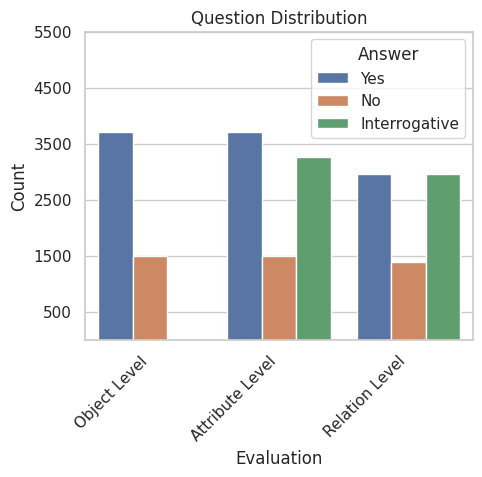

In [ ]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

data = {
    'Evaluation': ['Object Level', 'Attribute Level','Relation Level'],
    'Yes': [3715, 3715, 2967],
    'No': [1495, 1495, 1382],
    'Interrogative': [0, 3272, 2966]
}

df = pd.DataFrame(data)

# Melt the dataframe to long format
df_melted = df.melt(id_vars='Evaluation', var_name='Answer', value_name='Count')

# Plot
sns.set(style="whitegrid")
plt.figure(figsize=(5, 4))
sns.barplot(data=df_melted, x='Evaluation', y='Count', hue='Answer')
plt.xticks(rotation=45, ha='right')
plt.yticks(np.arange(500, max(df_melted['Count']) + 2000, 1000))
plt.title('Question Distribution')
plt.ylabel('Count')
plt.show()


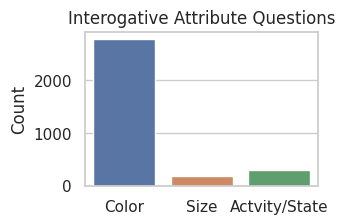

In [ ]:
data = {
    'Color':[ 2783],
    'Size': [184],
    'Actvity/State': [308]
}

df = pd.DataFrame(data)

# Plot
sns.set(style="whitegrid")
plt.figure(figsize=(3, 2))
sns.barplot(data=df)
plt.title('Interogative Attribute Questions')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()


In [ ]:
"""
of --> Is there a/an {subject} {relation} the {object} in the image?
      when object is living objects
      Who has a/an {subject} in the image? A: object
      Else
      What has a/an {subject} in the image? A: object


ing/ed --> Is the {sub} {relation} the {object} in the image?
       Who is {relation} the {object} in the image? A: subject
       What is {relation} the {object} in the image? A: subject

at --> Is there a/an {subject} {relation} the {object} in the image?
      when subject is living objects
      Who is {relation} the {object} in the image?
      Else
      What is {relation} the {object} in the image?


has/with --> Does the {subject} have a/an {object} in the image?
        What does the {subject} have? A: object

in --> Is there a/an {subject} {relation} the {object} in the image?
      Where is the {subject} in the image? A: {relation} the {object}

on --> Is there a/an {subject} {relation} the {object} in the image?
      when subject is living objects
      Who is {relation} the {object} in the image? A: subject
      Else
      What is {relation} the {object} in the image? A: subject

over/under/above/near/behind --> Is there a/an {subject} {relation} the {object} in the image?

near --> when subject is living objects
      Who is {relation} the {object} in the image? A: subject
      Else
      What is {relation} the {object} in the image? A: subject

behind --> when subject is living objects
      Who is {relation} the {object} in the image? A: subject
      Else
      What is {relation} the {object} in the image? A: subject

"""

#Method 2: Question Generation from Caption

In [ ]:
data = pd.read_excel(path+"MSCOCO_Objects.xlsx")
data

##Caption Generation

In [ ]:
from transformers import AutoProcessor, Blip2ForConditionalGeneration
import torch

processor = AutoProcessor.from_pretrained("Salesforce/blip2-opt-2.7b")
# by default `from_pretrained` loads the weights in float32
# we load in float16 instead to save memory
model = Blip2ForConditionalGeneration.from_pretrained("Salesforce/blip2-opt-2.7b", torch_dtype=torch.float16)

In [ ]:
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
model = model.to(device)

In [ ]:
from PIL import Image

def caption_generator(image_list):
  caption_list = list()
  for i in tqdm(range(len(image_list)), desc ="Generating Captions: "):
      img = image_path+image_list[i]
      image = Image.open(img).convert('RGB')

      inputs = processor(image, return_tensors="pt").to(device, torch.float16)

      generated_ids = model.generate(**inputs, max_new_tokens=20)
      generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0].strip()
      caption_list.append(str(generated_text))
  return caption_list

captions = caption_generator(data['image'].tolist())
captions

In [ ]:
data['caption'][0:5]

In [ ]:
# data['g_caption'] = captions
# data.to_excel(path+"MSCOCO_Objects.xlsx", index = False)

## Extract Objects and Attributes

In [ ]:
file = pd.read_excel(path+"MSCOCO_Objects.xlsx")
file

In [ ]:
def extract_objects_attributes(caption_list):

  import spacy
  import ast
  from tqdm import tqdm

  # Load the English language model
  nlp = spacy.load("en_core_web_sm")

  # Function to extract nouns, their counts, adjectives, and associated verbs or states from a sentence
  def extract_nouns_counts_adjectives_verbs(sentence):
      doc = nlp(sentence)
      noun_info_dict = {}
      for token in doc:
          if token.pos_ == "NOUN" or token.pos_ == "PROPN":
              noun = token.text
              num_flag = False
              adjective = None
              verb = None
              # Search for associated numeral
              for child in token.children:
                  if child.pos_ == "NUM":
                      count = child.text
                      num_flag = True
              # If numeral found, search for associated adjective and verb
              if num_flag:
                  if noun not in noun_info_dict:
                      noun_info_dict[noun] = {'numeral': [], 'adjective': [], 'verb': []}
                  for child in token.children:
                      if child.pos_ == "ADJ":
                          adjective = child.text
                          noun_info_dict[noun]['adjective'].append(adjective)
                      if child.pos_ == "VERB" or child.pos_ == "AUX":
                          verb = child.text
                          noun_info_dict[noun]['verb'].append(verb)
                      if child.pos_ == "NUM":
                          count = child.text
                          noun_info_dict[noun]['numeral'].append(count)
              else:
                  if noun not in noun_info_dict:
                      noun_info_dict[noun] = {'numeral': [], 'adjective': [], 'verb': []}
                  for child in token.children:
                      if child.pos_ == "ADJ":
                          adjective = child.text
                          noun_info_dict[noun]['adjective'].append(adjective)
                      if child.pos_ == "VERB" or child.pos_ == "AUX":
                          verb = child.text
                          noun_info_dict[noun]['verb'].append(verb)
      return noun_info_dict

  # Result dictionary to store information
  result_list = list()

  # Iterate over sentences and extract nouns, counts, adjectives, and verbs
  for i in tqdm(range(len(caption_list)), desc='Extracting Objects and Their Attributes'):
      sentence = caption_list[i].lower()
      noun_info_dict = extract_nouns_counts_adjectives_verbs(sentence)
      #print(noun_info_dict)
      result_list.append(ast.literal_eval(noun_info_dict))

  return result_list

In [ ]:
result_list = extract_objects_attributes(file['g_caption'].tolist())
result_list

In [ ]:
file['Entities'] = result_list

In [ ]:
# file = file[["image_id","image","caption","Entities"]]
# file.to_excel(path+"MSCOCO_500_Entities.xlsx",index = False)

## Extract Relationships

### Setup and Requirements



In [ ]:
#Do it only first time!
!wget https://nlp.stanford.edu/software/stanford-corenlp-full-2018-10-05.zip
!unzip stanford-corenlp-full-2018-10-05.zip

In [ ]:
!pip install stanza
!pip install textacy
!pip install spacy
!python -m spacy download en_core_web_sm
#NLTK Installation
import nltk
nltk.download('all')
!pip install word2number
!pip install rdflib
!pip install SPARQLWrapper

In [ ]:
import os
os.environ["CORENLP_HOME"] = '/content/stanford-corenlp-full-2018-10-05'

In [ ]:
def remove_special_characters(text):
  import re
  # Create a regex pattern to match all characters except letter or number
  pattern = r"[^A-Za-z0-9.,?!;:']+"
  # Remove special characters from the string
  text = re.sub(pattern, ' ', text)
  return text

file[ 'g_caption'] = file['g_caption'].apply(remove_special_characters)

In [ ]:
%cd stanford-corenlp-full-2018-10-05

/content/stanford-corenlp-full-2018-10-05


In [ ]:
import stanza
# Import client module
from stanza.server import CoreNLPClient

client = CoreNLPClient(timeout=1500000000000, be_quiet=True, annotators=['openie'],
endpoint='http://localhost:8100')

INFO:stanza:Writing properties to tmp file: corenlp_server-0db9647494494dc7.props


In [ ]:
!ps aux | grep java
!pkill -f java

root        7105  0.0  0.0   7376  3404 ?        S    12:57   0:00 /bin/bash -c ps aux | grep java
root        7107  0.0  0.0   6484  2268 ?        S    12:57   0:00 grep java


In [ ]:
import time

def relation_extraction(caption_list):

  # Create a list to store the triples
  relations = []

  # Iterate over the list of captions
  for i in tqdm(range(len(caption_list)), desc='Extracting Relations: '):
    caption = caption_list[i]

    client.start()
    time.sleep(10)
    client.is_alive()
    document = client.annotate(caption, properties={"annotators":"tokenize,ssplit,pos,depparse,natlog,openie",
                                    "outputFormat": "json","openie.triple.strict":"true"})


    triples = []
    for sentence in document['sentences']:
      for triple in sentence['openie']:
        try:
          triples.append({
              'subject': triple['subject'],
              'relation': triple['relation'],
              'object': triple['object']
          })
        except:
          pass
      #Printing triples
    relations.append(triples)
    client.stop()
    time.sleep(10)
  return relations

In [ ]:
relations = relation_extraction(file['g_caption'].tolist())
relations

In [ ]:
# file[ 'relations'] = relations
# file = file[["image_id","image","g_caption","Entities","relations"]]
# file.to_excel(path+"MSCOCO_caption_Relations.xlsx",index = False)

##Question Template

In [ ]:
import ast
file = pd.read_excel(path+"MSCOCO_caption_Relations.xlsx")
file

,image_id,image,g_caption,Entities,relations
0,314880,COCO_val2014_000000314880.jpg,a group of people playing frisbee in a park,"{'group': {'numeral': [], 'adjective': [], 've...",[]
1,402909,COCO_val2014_000000402909.jpg,a train is parked at a train station,"{'train': {'numeral': [], 'adjective': [], 've...","[{'subject': 'train', 'relation': 'is', 'objec..."
2,166747,COCO_val2014_000000166747.jpg,a horse pulling a trolley with people on it,"{'horse': {'numeral': [], 'adjective': [], 've...","[{'subject': 'horse', 'relation': 'pulling tro..."
3,198271,COCO_val2014_000000198271.jpg,a large church with a clock tower,"{'church': {'numeral': [], 'adjective': ['larg...","[{'subject': 'large church', 'relation': 'is w..."
4,422157,COCO_val2014_000000422157.jpg,a yellow bus driving down a street,"{'bus': {'numeral': [], 'adjective': ['yellow'...",[]
...,...,...,...,...,...
496,578654,COCO_val2014_000000578654.jpg,a purple couch with a blue and white pillow,"{'couch': {'numeral': [], 'adjective': ['purpl...","[{'subject': 'purple couch', 'relation': 'is w..."
497,214975,COCO_val2014_000000214975.jpg,a cake with a truck on it,"{'cake': {'numeral': [], 'adjective': [], 'ver...","[{'subject': 'cake', 'relation': 'is with', 'o..."
498,428452,COCO_val2014_000000428452.jpg,a sandwich on a plate,"{'sandwich': {'numeral': [], 'adjective': [], ...",[]
499,306524,COCO_val2014_000000306524.jpg,a large building with a clock on the front,"{'building': {'numeral': [], 'adjective': ['la...","[{'subject': 'large building', 'relation': 'is..."


In [ ]:
def convert_to_dict(text):
  import ast
  ans = ast.literal_eval(text)
  return ans

file['Entities'] = file['Entities'].apply(convert_to_dict)
file['relations'] = file['relations'].apply(convert_to_dict)
file['Entities']

0      {'group': {'numeral': [], 'adjective': [], 've...
1      {'train': {'numeral': [], 'adjective': [], 've...
2      {'horse': {'numeral': [], 'adjective': [], 've...
3      {'church': {'numeral': [], 'adjective': ['larg...
4      {'bus': {'numeral': [], 'adjective': ['yellow'...
                             ...                        
496    {'couch': {'numeral': [], 'adjective': ['purpl...
497    {'cake': {'numeral': [], 'adjective': [], 'ver...
498    {'sandwich': {'numeral': [], 'adjective': [], ...
499    {'building': {'numeral': [], 'adjective': ['la...
500    {'row': {'numeral': [], 'adjective': [], 'verb...
Name: Entities, Length: 501, dtype: object

In [ ]:
# a = [ {'teddy': {'numeral': ['three'], 'adjective': [], 'verb': []},
#  'bear': {'numeral': [], 'adjective': ['young','black'], 'verb': ['wearing']},
#  'hat': {'numeral': [], 'adjective': ['red'], 'verb': []},
#  'scarf': {'numeral': [], 'adjective': ['green'], 'verb': []}},
#   {'boy': {'numeral': ['four'], 'adjective': [], 'verb': []},
#  'dog': {'numeral': [], 'adjective': ['blue'], 'verb': ['playing']},
#  'apple': {'numeral': [], 'adjective': ['red'], 'verb': []},
#  'man': {'numeral': [], 'adjective': ['green'], 'verb': []}}]
# a

In [ ]:
def make_list(entity,relations):

  '''
  This function takes a list of entities and returns a dictionary of
  lists of objects, numerals, adjectives, and verbs.
  '''
  object_list = list()
  numeral_list = list()
  adjective_list = list()
  verb_list = list()
  relation_list = list()

  # Unique objects, numeral, adjectives, and verbs
  for a in entity:
    for key, value in a.items():
      object_list.append(key)
      for k,v in value.items():
        if k == 'numeral':
          if v:
            for i in v:
              numeral_list.append(i)
        elif k == 'adjective':
          if v:
            for i in v:
              adjective_list.append(i)
        elif k == 'verb':
          if v:
            for i in v:
              verb_list.append(i)

  # unique relations
  for relation in relations:
    for rel in relation:
      for k,v in rel.items():
        if k == 'relation':
          if v:
            relation_list.append(v)



  return {'objects':set(object_list),
           'numeral':set(numeral_list),
           'adjectives':set(adjective_list),
           'verbs':set(verb_list),
          'relations':set(relation_list)}

###
unique_entities = make_list(file['Entities'].tolist(),file['relations'].tolist())
unique_entities


{'objects': {'accordion',
  'adults',
  'air',
  'airlines',
  'airplane',
  'airplanes',
  'airport',
  'animal',
  'animals',
  'apple',
  'apples',
  'appliances',
  'area',
  'arena',
  'avenue',
  'baby',
  'back',
  'background',
  'bag',
  'ball',
  'banana',
  'bananas',
  'bar',
  'baseball',
  'basket',
  'bat',
  'bathroom',
  'bathtub',
  'beach',
  'bear',
  'bears',
  'bed',
  'bedroom',
  'bench',
  'bicycle',
  'bicycles',
  'bike',
  'bird',
  'birds',
  'blanket',
  'blender',
  'board',
  'boat',
  'body',
  'book',
  'bookcase',
  'bottle',
  'bottles',
  'bowl',
  'box',
  'boy',
  'branch',
  'brick',
  'bridge',
  'broccoli',
  'brussels',
  'building',
  'buildings',
  'bunch',
  'bunches',
  'burners',
  'bus',
  'buses',
  'butter',
  'cabinet',
  'cage',
  'cake',
  'calves',
  'camera',
  'candle',
  'candles',
  'car',
  'carriage',
  'carrots',
  'cars',
  'cart',
  'castle',
  'cat',
  'catcher',
  'cats',
  'cd',
  'ceiling',
  'cell',
  'chair',
  'chai

In [ ]:
# unique_entities = make_list(file['Entities'].tolist(),file['relations'].tolist())
# unique_entities['relations']

In [ ]:
def get_attr_type(word):
    '''
    This function returns is the color present in the list of colors.
    '''
    colors = ['black and white','gray','grey','red','blue','white','green','pink','bright blue','teal','greenish',
              'silver','dark blue','golden','yellow',
              'black','ivory','gold','orange','purple','brown','khaki','golden brown']
    sizes = ['tall','short','long','small','large','little','huge','halved','big','half']

    if word in colors:
        return 'color'
    elif word in sizes:
        return 'size'
    else:
      return 'none'



def get_article(word):
    '''
    This function returns the article for a given word.
    If the word starts with a vowel, the article is 'an', otherwise 'a'.
    '''
    vowels = 'aeiou'
    if word[0].lower() in vowels:
        return 'an'
    else:
        return 'a'


def get_aux_verb(word):
    '''
    This function returns the auxiliary verb for a given word.
    If the word ends with s/es, the verb is 'are', otherwise 'is'.
    '''
    plurals = ['s','es']
    if word.endswith(tuple(plurals)):
        return 'are'
    else:
        return 'is'


def random_k_sampling(all_elements, present_elements, k):
    """
    This function will return k non-existent element (object, adjective, verb)
    """
    import random
    non_exist_elements = []

    # Generate a list of elements from all elements that are not in current image
    available_elements = [elm for elm in all_elements if elm not in present_elements]
    # Select k elements from available elements
    random_elements = random.sample(available_elements, k)
    # Append the selected elements to non_existent elements
    non_exist_elements.extend(random_elements)

    return non_exist_elements


In [ ]:
#增加负样本前版本

def generate_question_templates(data, negative_question_count):
    '''
    This function generates the question templates for the given entities and relations.
    '''
    image_id = data['image_id'].tolist()
    image_name = data['image'].tolist()
    all_entities = data['Entities'].tolist()
    all_relations = data['relations'].tolist()

    # all the unique objects, attributes and relations
    unique_entities = make_list(all_entities,all_relations)

    all_questions = []

    for i, obj_info in enumerate(all_entities):
        num_obj = len(obj_info.keys())
        negative_question_count = num_obj
        questions = []
        # Object presence question template
        for obj in obj_info.keys():
            article = get_article(obj)
            question_obj_presence = f"Is there {article} {obj} in the image?"
            answer_tmp_obj =  f", there is {article} {obj} in the image."
            questions.append({"root":obj, "depend":"no", "SN":i,"id":image_id[i], "image":image_name[i], "question":question_obj_presence,
                              "answer":"yes", "long_answer":"yes"+answer_tmp_obj, "type":"yes/no", "evaluation":"object_existence"})

        ### Negative objects
        non_exist_objects = random_k_sampling(unique_entities['objects'], obj_info.keys(), negative_question_count)
        for k in non_exist_objects:
            article = get_article(k)
            question_obj_absence = f"Is there {article} {k} in the image?"
            answer_tmp_neg_obj =  f", there is no {k} in the image."
            questions.append({"root":k, "depend":"no", "SN":i,"id":image_id[i], "image":image_name[i], "question":question_obj_absence,
                              "answer":"no","long_answer":"no"+answer_tmp_neg_obj, "type":"yes/no", "evaluation":"negative_object_existence"})


        # Attribute presence question template
        for obj, attributes in obj_info.items():
            for attr, values in attributes.items():
              if attr == 'numeral':
                if values:
                  for value in values:
                    question_num_presence = f"Are there {value} {obj} in the image?"
                    answer_tmp_num =  f", there are {value} {obj} in the image."
                    wh_question_num = f"How many {obj} are in the image?"
                    wh_answer_tmp_num =  f"there are {value} {obj} in the image."

                    questions.append({"root":"not", "depend":[obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_num_presence,
                                      "answer":"yes","long_answer":"yes"+answer_tmp_num, "type":"yes/no", "evaluation":"attribute_existence"})
                    questions.append({"root":"not", "depend":[obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_num,
                                      "answer":value, "long_answer":wh_answer_tmp_num, "type":"interrogative", "evaluation":"attribute_counting"})

                    for non_exist_object in non_exist_objects:
                      question_num_presence = f"Are there {value} {non_exist_object} in the image?"
                      answer_tmp_num =  f",there are no {non_exist_object} here."
                      wh_question_num = f"How many {non_exist_object} are in the image?"
                      wh_answer_tmp_num =  f"there are no {non_exist_object} in the image."

                      questions.append({"root":"not", "depend":[non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_num_presence,
                                        "answer":"no","long_answer":"no"+answer_tmp_num, "type":"yes/no", "evaluation":"attribute_existence"})
                      questions.append({"root":"not", "depend":[non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_num,
                                        "answer":"none", "long_answer":wh_answer_tmp_num, "type":"interrogative", "evaluation":"attribute_counting"})



              if attr == 'adjective':
                if values:
                  verb = get_aux_verb(obj)
                  for value in values:
                    question_adj_presence = f"{verb.capitalize()} the {obj} in the image {value}?"
                    answer_tmp_adj =  f", the {obj} in the image {verb.capitalize()} {value}."
                    questions.append({"root":"not", "depend":[obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_adj_presence,
                                      "answer":"yes","long_answer":"yes"+answer_tmp_adj, "type":"yes/no", "evaluation":"attribute_existence"})
                    # Wh Question
                    for non_exist_object in non_exist_objects:
                      question_adj_presence = f"{verb.capitalize()} the {non_exist_object} in the image {value}?"
                      answer_tmp_adj =  f",there are no {non_exist_object} here."
                      questions.append({"root":"not", "depend":[non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_adj_presence,
                                        "answer":"no","long_answer":"no"+answer_tmp_adj, "type":"yes/no", "evaluation":"attribute_existence"})
                      # Wh Question
                    attr_type = get_attr_type(value)
                    if attr_type == 'color':
                      wh_question_color = f"What is the color of {obj} in the image?"
                      wh_answer_color =  f"the color of the {obj} in the image is {value}."
                      questions.append({"root":"not", "depend":[obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_color,
                                        "answer":value,"long_answer":wh_answer_color, "type":"interrogative", "evaluation":"attribute_color"})
                      for non_exist_object in non_exist_objects:
                        wh_question_color = f"What is the color of {non_exist_object} in the image?"
                        wh_answer_color =  f"there are no {non_exist_object} in the image."
                        questions.append({"root":"not", "depend":[non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_color,
                                          "answer":"none","long_answer":wh_answer_color, "type":"interrogative", "evaluation":"attribute_color"})
                    elif attr_type == 'size':
                      wh_question_shape = f"What is the shape of {obj} in the image?"
                      wh_answer_shape =  f"the shape of the {obj} in the image is {value}."
                      questions.append({"root":"not", "depend":[obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_shape,
                                        "answer":value, "long_answer": wh_answer_shape, "type":"interrogative", "evaluation":"attribute_shape"})
                      for non_exist_object in non_exist_objects:
                        wh_question_shape = f"What is the shape of {non_exist_object} in the image?"
                        wh_answer_shape =  f"there are no {non_exist_object} in the image."
                        questions.append({"root":"not", "depend":[non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_shape,
                                          "answer":"none", "long_answer": wh_answer_shape, "type":"interrogative", "evaluation":"attribute_shape"})
                  # Negative Attributes
                  non_exist_adjectives = random_k_sampling(unique_entities['adjectives'], values, len(values))
                  for k in non_exist_adjectives:
                    question_adj_absence = f"Is the {obj} in the image {k}?"
                    answer_tmp_neg_adj =  f", the {obj} in the image is not {k}."
                    questions.append({"root":"not", "depend":"no", "SN":i,"id":image_id[i], "image":image_name[i], "question":question_adj_absence,
                                      "answer":"no", "long_answer":"no"+answer_tmp_neg_adj, "type":"yes/no", "evaluation":"negative_attribute_existence"})
                    for non_exist_object in non_exist_objects:
                      question_adj_absence = f"Is the {non_exist_object} in the image {k}?"
                      answer_tmp_neg_adj =  f",there are no {non_exist_object} here."
                      questions.append({"root":"not", "depend":[non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_adj_absence,
                                        "answer":"no", "long_answer":"no"+answer_tmp_neg_adj, "type":"yes/no", "evaluation":"negative_attribute_existence"})

              if attr == 'verb':
                for value in values:
                    question_verb_presence = f"Is the {obj} in the image {value}?"
                    answer_tmp_verb =  f", the {obj} is {value} in the image."
                    questions.append({"root":"not", "depend":[obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_verb_presence,
                                      "answer":"yes","long_answer":"yes"+ answer_tmp_verb , "type":"yes/no", "evaluation":"attribute_existence"})
                    for non_exist_object in non_exist_objects:
                      question_verb_presence = f"Is the {non_exist_object} in the image {value}?"
                      answer_tmp_verb =  f",there are no {non_exist_object} here."
                      questions.append({"root":"not", "depend":[non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_verb_presence,
                                        "answer":"no","long_answer":"no"+ answer_tmp_verb , "type":"yes/no", "evaluation":"attribute_existence"})
                    # Wh Question

                    if value.endswith('ing'):   # Present Participle (Who)
                      wh_question_verb = f"Who is {value} in the image?"
                      wh_answer_verb =  f"the {obj} is {value} in the image."
                      questions.append({"root":"not", "depend":[obj], "SN":i,"id":image_id[i], "image":image_name[i],"question":wh_question_verb,
                                        "answer":obj, "long_answer":wh_answer_verb, "type":"interrogative", "evaluation":"attribute_activity/state"})
                    if value.endswith('ed'):   # Past Participle (What)
                      wh_question_verb = f"What is {value} in the image?"
                      wh_answer_verb =  f"the {obj} is {value} in the image."
                      questions.append({"root":"not", "depend":[obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_verb,
                                        "answer":obj, "long_answer":wh_answer_verb, "type":"interrogative", "evaluation":"attribute_activity/state"})

              # Negative Activity
                non_exist_verbs = random_k_sampling(unique_entities['verbs'], values, len(values))
                for k in non_exist_verbs:
                  question_verb_absence = f"Is the {obj} in the image {k}?"
                  answer_tmp_neg_verb =  f", the {obj} is not {k} in the image."
                  questions.append({"root":"not", "depend":"no", "SN":i,"id":image_id[i], "image":image_name[i], "question":question_verb_absence,
                                    "answer":"no","long_answer":"no"+answer_tmp_neg_verb, "type":"yes/no", "evaluation":"negative_attribute_existence"})
                  for non_exist_object in non_exist_objects:
                    question_verb_absence = f"Is the {non_exist_object} in the image {k}?"
                    answer_tmp_neg_verb =  f",there are no {non_exist_object} here."
                    questions.append({"root":"not", "depend":[non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_verb_absence,
                                      "answer":"no","long_answer":"no"+answer_tmp_neg_verb, "type":"yes/no", "evaluation":"negative_attribute_existence"})
        # Relation presence question template
        relations = all_relations[i]
        if relations:
            present_relations = [list(i.values())[1] for i in relations ]

            for j, rel in enumerate(relations):

              values = list(rel.values())
              sub = values[0]
              relat = values[1]
              obj = values[2]

              ### Positive relations

              if relat == 'is' or relat == 'are':
                question_relation_presence = f"{relat.capitalize()} the {sub} {obj} in the image?"
                relat_ans_temp = f", the {sub} {relat} {obj} in the image."
                questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_presence,
                                  "answer":"yes","long_answer":"yes"+ relat_ans_temp ,"type":"yes/no", "evaluation":"relation_existence"})
                for non_exist_object in non_exist_objects:
                  question_relation_presence = f"{relat.capitalize()} the {sub} {non_exist_object} in the image?"
                  relat_ans_temp = f",there are no {non_exist_object} here."
                  questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_presence,
                                    "answer":"no","long_answer":"no"+ relat_ans_temp ,"type":"yes/no", "evaluation":"relation_existence"})
              elif relat.find('is') != -1 or relat.find('are')!=-1:
                if len(relat.split())> 1:
                  verb = relat.split()[0]
                  new_relat = " ".join(relat.split()[1:])
                  question_relation_presence = f"{verb.capitalize()} the {sub} {new_relat} {obj} in the image?"
                  relat_ans_temp = f", the {sub} {verb} {new_relat} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_presence,
                                    "answer":"yes","long_answer":"yes"+ relat_ans_temp, "type":"yes/no", "evaluation":"relation_existence"})
                  for non_exist_object in non_exist_objects:
                    verb = relat.split()[0]
                    new_relat = " ".join(relat.split()[1:])
                    question_relation_presence = f"{verb.capitalize()} the {sub} {new_relat} {non_exist_object} in the image?"
                    relat_ans_temp = f",there are no {non_exist_object} here."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_presence,
                                      "answer":"no","long_answer":"no"+ relat_ans_temp, "type":"yes/no", "evaluation":"relation_existence"})
              else:
                if sub.endswith('s'):
                  question_relation_presence = f"Are the {sub} {relat} {obj} in the image?"
                  relat_ans_temp = f", the {sub} are {relat} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_presence,
                                    "answer":"yes","long_answer":"yes"+ relat_ans_temp, "type":"yes/no", "evaluation":"relation_existence"})
                  for non_exist_object in non_exist_objects:
                    question_relation_presence = f"Are the {sub} {relat} {non_exist_object} in the image?"
                    relat_ans_temp = f",there are no {non_exist_object} here."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_presence,
                                      "answer":"no","long_answer":"no"+ relat_ans_temp, "type":"yes/no", "evaluation":"relation_existence"})
                else:
                  question_relation_presence = f"Is the {sub} {relat} {obj} in the image?"
                  relat_ans_temp = f", the {sub} is {relat} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_presence,
                                    "answer":"yes","long_answer":"yes"+ relat_ans_temp, "type":"yes/no", "evaluation":"relation_existence"})
                  for non_exist_object in non_exist_objects:
                    question_relation_presence = f"Is the {sub} {relat} {non_exist_object} in the image?"
                    relat_ans_temp = f",there are no {non_exist_object} here."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_presence,
                                      "answer":"no","long_answer":"no"+ relat_ans_temp, "type":"yes/no", "evaluation":"relation_existence"})

              ### Negative relations
              non_exist_relation= random_k_sampling(unique_entities['relations'], present_relations, len(present_relations))
              if non_exist_relation[j] == 'is' or non_exist_relation[j] == 'are':
                question_relation_absence = f"{non_exist_relation[j].capitalize()} the {sub} {obj} in the image?"
                relat_ans_neg_temp = f", the {sub} {non_exist_relation[j]} not {obj} in the image."
                questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_absence,
                                  "answer":"no", "long_answer":"no"+ relat_ans_neg_temp, "type":"yes/no", "evaluation":"negative_relation_existence"})
                for non_exist_object in non_exist_objects:
                  question_relation_absence = f"{non_exist_relation[j].capitalize()} the {sub} {non_exist_object} in the image?"
                  relat_ans_neg_temp = f",there are no {non_exist_object} here."
                  questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_absence,
                                    "answer":"no", "long_answer":"no"+ relat_ans_neg_temp, "type":"yes/no", "evaluation":"negative_relation_existence"})
              elif non_exist_relation[j].find('is') != -1 or non_exist_relation[j].find('are')!=-1:
                if len(non_exist_relation[j].split())> 1:
                  verb = non_exist_relation[j].split()[0]
                  new_relat = " ".join(non_exist_relation[j].split()[1:])
                  question_relation_absence = f"{verb.capitalize()} the {sub} {new_relat} {obj} in the image?"
                  relat_ans_neg_temp = f", the {sub} {verb} not {new_relat} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_absence,
                                    "answer":"no","long_answer":"no"+ relat_ans_neg_temp, "type":"yes/no", "evaluation":"negative_relation_existence"})
                  for non_exist_object in non_exist_objects:
                    verb = non_exist_relation[j].split()[0]
                    new_relat = " ".join(non_exist_relation[j].split()[1:])
                    question_relation_absence = f"{verb.capitalize()} the {sub} {new_relat} {non_exist_object} in the image?"
                    relat_ans_neg_temp = f",there are no {non_exist_object} here."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_absence,
                                      "answer":"no","long_answer":"no"+ relat_ans_neg_temp, "type":"yes/no", "evaluation":"negative_relation_existence"})
              else:

                if sub.endswith('s'):
                  question_relation_absence = f"Are the {sub} {non_exist_relation[j]} {obj} in the image?"
                  relat_ans_neg_temp = f", the {sub} are not {non_exist_relation[j]} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_absence,
                                    "answer":"no", "long_answer":"no"+ relat_ans_neg_temp, "type":"yes/no", "evaluation":"negative_relation_existence"})
                  for non_exist_object in non_exist_objects:
                    question_relation_absence = f"Are the {sub} {non_exist_relation[j]} {non_exist_object} in the image?"
                    relat_ans_neg_temp = f",there are no {non_exist_object} here."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_absence,
                                      "answer":"no", "long_answer":"no"+ relat_ans_neg_temp, "type":"yes/no", "evaluation":"negative_relation_existence"})
                else:
                  question_relation_absence = f"Is the {sub} {non_exist_relation[j]} {obj} in the image?"
                  relat_ans_neg_temp = f", the {sub} is not {non_exist_relation[j]} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_absence,
                                    "answer":"no","long_answer":"no"+ relat_ans_neg_temp, "type":"yes/no", "evaluation":"negative_relation_existence"})
                  for non_exist_object in non_exist_objects:
                    question_relation_absence = f"Is the {sub} {non_exist_relation[j]} {non_exist_object} in the image?"
                    relat_ans_neg_temp = f",there are no {non_exist_object} here."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":question_relation_absence,
                                      "answer":"no","long_answer":"no"+ relat_ans_neg_temp, "type":"yes/no", "evaluation":"negative_relation_existence"})
              if len(sub.split())== 1:   # if the subject is single word

                # if the relation is two word and first word endswith 'ing'
                if len(relat.split()) < 3 and relat.split()[0].endswith('ing'):
                  wh_question_relation = f"Who is {relat} {obj} in the image?"
                  wh_answer_relation =  f"the {sub} is {relat} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_relation ,
                                    "answer":sub, "long_answer":wh_answer_relation, "type":"interrogative", "evaluation":"relation"})
                  for non_exist_object in non_exist_objects:
                    wh_question_relation = f"Who is {relat} {non_exist_object} in the image?"
                    wh_answer_relation =  f"there are no {non_exist_object} in the image."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_relation ,
                                      "answer":"none", "long_answer":wh_answer_relation, "type":"interrogative", "evaluation":"relation"})
                # if the relation is two word and first word endswith 'ed'
                if len(relat.split()) <3 and relat.split()[0].endswith('ed'):
                  wh_question_relation = f"What is {relat} {obj} in the image?"
                  wh_answer_relation =  f"the {sub} is {relat} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_relation ,
                                    "answer":sub,"long_answer":wh_answer_relation, "type":"interrogative", "evaluation":"relation"})
                  for non_exist_object in non_exist_objects:
                    wh_question_relation = f"What is {relat} {non_exist_object} in the image?"
                    wh_answer_relation =  f"there are no {non_exist_object} in the image."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_relation ,
                                      "answer":"none","long_answer":wh_answer_relation, "type":"interrogative", "evaluation":"relation"})

                # if the relation is more than two word and first word 'is' and second word endswith 'ing'
                if len(relat.split())> 2 and relat.split()[0] == 'is' and relat.split()[1].endswith('ing'):
                  wh_question_relation = f"Who {relat} {obj} in the image?"
                  wh_answer_relation =  f"the {sub} {relat} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_relation ,
                                    "answer":sub,"long_answer":wh_answer_relation, "type":"interrogative", "evaluation":"relation"})
                  for non_exist_object in non_exist_objects:
                    wh_question_relation = f"Who {relat} {non_exist_object} in the image?"
                    wh_answer_relation =  f"there are no {non_exist_object} in the image."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_relation ,
                                      "answer":"none","long_answer":wh_answer_relation, "type":"interrogative", "evaluation":"relation"})
                # if the relation is more than two word and first word 'is' and second word endswith 'ed'
                if len(relat.split())> 2 and relat.split()[0] == 'is' and relat.split()[1].endswith('ed'):
                  wh_question_relation = f"What {relat} {obj} in the image?"
                  wh_answer_relation =  f"the {sub} {relat} {obj} in the image."
                  questions.append({"root":"not", "depend":[sub,obj], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_relation ,
                                    "answer":sub,"long_answer":wh_answer_relation, "type":"interrogative", "evaluation":"relation"})
                  for non_exist_object in non_exist_objects:
                    wh_question_relation = f"What {relat} {non_exist_object} in the image?"
                    wh_answer_relation =  f"there are no {non_exist_object} in the image."
                    questions.append({"root":"not", "depend":[sub,non_exist_object], "SN":i,"id":image_id[i], "image":image_name[i], "question":wh_question_relation ,
                                      "answer":"none","long_answer":wh_answer_relation, "type":"interrogative", "evaluation":"relation"})

        all_questions.append(questions)


    return all_questions

# Generating question templates
question_templates = generate_question_templates(file,3)


In [ ]:
question_templates

[[{'root': 'group',
   'depend': 'no',
   'SN': 0,
   'id': 314880,
   'image': 'COCO_val2014_000000314880.jpg',
   'question': 'Is there a group in the image?',
   'answer': 'yes',
   'long_answer': 'yes, there is a group in the image.',
   'type': 'yes/no',
   'evaluation': 'object_existence'},
  {'root': 'people',
   'depend': 'no',
   'SN': 0,
   'id': 314880,
   'image': 'COCO_val2014_000000314880.jpg',
   'question': 'Is there a people in the image?',
   'answer': 'yes',
   'long_answer': 'yes, there is a people in the image.',
   'type': 'yes/no',
   'evaluation': 'object_existence'},
  {'root': 'frisbee',
   'depend': 'no',
   'SN': 0,
   'id': 314880,
   'image': 'COCO_val2014_000000314880.jpg',
   'question': 'Is there a frisbee in the image?',
   'answer': 'yes',
   'long_answer': 'yes, there is a frisbee in the image.',
   'type': 'yes/no',
   'evaluation': 'object_existence'},
  {'root': 'park',
   'depend': 'no',
   'SN': 0,
   'id': 314880,
   'image': 'COCO_val2014_0000

In [ ]:
len(question_templates)

501

In [ ]:
questions = list()
for i in range(len(question_templates)):
  for j in range(len(question_templates[i])):
    questions.append(question_templates[i][j])

len(questions)

13007

In [ ]:
questions

[{'root': 'group',
  'depend': 'no',
  'SN': 0,
  'id': 314880,
  'image': 'COCO_val2014_000000314880.jpg',
  'question': 'Is there a group in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there is a group in the image.',
  'type': 'yes/no',
  'evaluation': 'object_existence'},
 {'root': 'people',
  'depend': 'no',
  'SN': 0,
  'id': 314880,
  'image': 'COCO_val2014_000000314880.jpg',
  'question': 'Is there a people in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there is a people in the image.',
  'type': 'yes/no',
  'evaluation': 'object_existence'},
 {'root': 'frisbee',
  'depend': 'no',
  'SN': 0,
  'id': 314880,
  'image': 'COCO_val2014_000000314880.jpg',
  'question': 'Is there a frisbee in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there is a frisbee in the image.',
  'type': 'yes/no',
  'evaluation': 'object_existence'},
 {'root': 'park',
  'depend': 'no',
  'SN': 0,
  'id': 314880,
  'image': 'COCO_val2014_000000314880.jpg',
  'question': 'Is th

In [ ]:
import json

with open(path+'add_root_qa_captions.json', 'w') as json_file:
    for item in questions:
        json.dump(item, json_file)
        json_file.write('\n')


In [ ]:
# Read data from the JSON file
with open(file_path, 'r') as json_file:
    data = json.load(json_file)

NameError: name 'file_path' is not defined

###Question Distribution

In [ ]:
info = list()
count_type = dict()
count_evaluation = dict()
for i in range(len(question_templates)):
  questions = question_templates[i]
  # count_type = dict()
  # count_evaluation = dict()
  for q in questions:
    tp = q['type']
    ev = q['evaluation']
    if tp not in count_type:
      count_type[tp] = 1
    else:
      count_type[tp] = count_type.get(tp, 0) + 1
    if ev not in count_evaluation:
      count_evaluation[ev] = 1
    else:
      count_evaluation[ev] = count_evaluation.get(ev, 0) + 1
info.append(count_type)
info.append(count_evaluation)

In [ ]:
238+24+56+50

368

In [ ]:
info

[{'yes/no': 11350, 'interrogative': 1657},
 {'object_existence': 1522,
  'negative_object_existence': 1522,
  'attribute_existence': 1702,
  'attribute_activity/state': 238,
  'negative_attribute_existence': 1520,
  'relation_existence': 2542,
  'negative_relation_existence': 2542,
  'relation': 943,
  'attribute_shape': 89,
  'attribute_color': 205,
  'attribute_counting': 182}]

In [ ]:
5082+943

6025

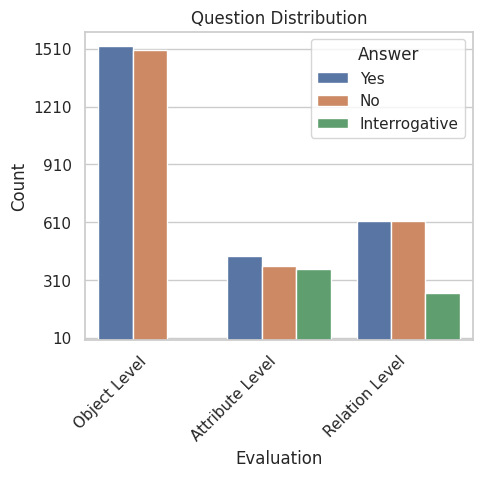

In [ ]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

data = {
    'Evaluation': ['Object Level', 'Attribute Level','Relation Level'],
    'Yes': [1522,434,614],
    'No': [1503,384, 614],
    'Interrogative': [0, 368, 240]
}

df = pd.DataFrame(data)

# Melt the dataframe to long format
df_melted = df.melt(id_vars='Evaluation', var_name='Answer', value_name='Count')

# Plot
sns.set(style="whitegrid")
plt.figure(figsize=(5, 4))
sns.barplot(data=df_melted, x='Evaluation', y='Count', hue='Answer')
plt.xticks(rotation=45, ha='right')
plt.yticks(np.arange(10, max(df_melted['Count']) + 100, 300))
plt.title('Question Distribution')
plt.ylabel('Count')
plt.show()


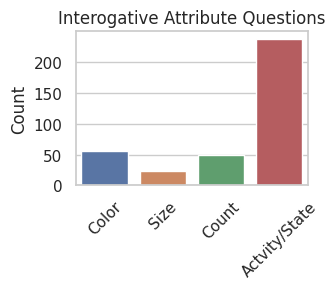

In [ ]:
data = {
    'Color':[56],
    'Size': [24],
    'Count':[50],
    'Actvity/State': [238]
}

df = pd.DataFrame(data)

# Plot
sns.set(style="whitegrid")
plt.figure(figsize=(3, 2))
sns.barplot(data=df)
plt.title('Interogative Attribute Questions')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()


#Testing

In [ ]:
import os
directory = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/MSCOCO-Val-500/MSCOCO_500_Val/"
files = os.listdir(directory)
len(files)

In [ ]:
for i in range(5):
  print(data['caption'][i])


In [ ]:
image_path = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/MSCOCO-Val-500/MSCOCO_500_Val/"

In [ ]:
data['image'][490]

'COCO_val2014_000000532919.jpg'

In [ ]:
import os
from PIL import Image

def display_images(image_names, directory):
    for name in image_names:
        image_path = os.path.join(directory, name)
        try:
            img = Image.open(image_path)
            img.show()
        except Exception as e:
            print(f"Error opening {image_path}: {e}")


image_names = data['image'][0:5].tolist()
directory = image_path
display_images(image_names, directory)

In [ ]:
image_names = data['image'][0:5].tolist()
image_names

['COCO_val2014_000000039477.jpg',
 'COCO_val2014_000000543497.jpg',
 'COCO_val2014_000000187475.jpg',
 'COCO_val2014_000000352684.jpg',
 'COCO_val2014_000000438723.jpg']

A withered apple that has been stabbed with blood in the background.


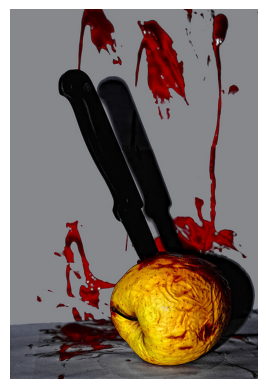

In [ ]:
from matplotlib import image as im

n = 94
img = im.imread(image_path+ data['image'][n],0)
plt.figure()
plt.axis('off')
plt.imshow(img)
print(data['caption'][n])
#plt.title('Human Damage')
#plt.savefig("coco.png",bbox_inches='tight')

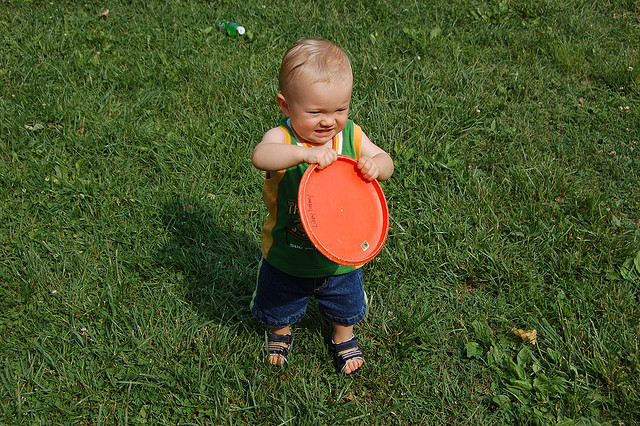

In [ ]:
from PIL import Image

image = Image.open(image_path+file1['image'][489])
image

#Segmentation using Oneformer

In [ ]:
!pip install -q git+https://github.com/huggingface/transformers.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
from transformers import AutoProcessor, AutoModelForUniversalSegmentation

# the Auto API loads a OneFormerProcessor for us, based on the checkpoint
processor = AutoProcessor.from_pretrained("shi-labs/oneformer_coco_swin_large")
model = AutoModelForUniversalSegmentation.from_pretrained("shi-labs/oneformer_coco_swin_large")

preprocessor_config.json:   0%|          | 0.00/6.82k [00:00<?, ?B/s]

coco_panoptic.json:   0%|          | 0.00/5.85k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/82.6k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/879M [00:00<?, ?B/s]

In [ ]:
from PIL import Image
import torch
path = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/MSCOCO-Val-500/MSCOCO_500_Val/"


substrings_to_remove = ['-other', '-other-merged', '-merged']
# Function to remove specified substrings from a string
def remove_substrings(s, substrings):
    for sub in substrings:
        s = s.replace(sub, '')
    return s


image_names = data['image'].tolist()
final_list = list()
for i, image_name in enumerate(image_names):
  image = Image.open(path+image_name)
  if (len(image.getbands())!=3):
    img = image.convert("RGB")
    panoptic_inputs = processor(images=img, task_inputs=["panoptic"], return_tensors="pt")
    processor.tokenizer.batch_decode(panoptic_inputs.task_inputs)

  else:
    panoptic_inputs = processor(images=image, task_inputs=["panoptic"], return_tensors="pt")
    processor.tokenizer.batch_decode(panoptic_inputs.task_inputs)

  object_list = list()
  with torch.no_grad():
    outputs = model(**panoptic_inputs)
  panoptic_segmentation = processor.post_process_panoptic_segmentation(outputs, target_sizes=[image.size[::-1]])[0]
  for segment in panoptic_segmentation['segments_info']:
        segment_id = segment['id']
        segment_label_id = segment['label_id']
        segment_label = model.config.id2label[segment_label_id]
        #print(segment_label)
        object_list.append(segment_label)
  # Remove substrings from each string in the list
  object_list = [remove_substrings(s, substrings_to_remove) for s in object_list]
  final_list.append(object_list)
  print("Image No: ",i+1)
  print(object_list)


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  1
['person', 'person', 'person', 'tree', 'person', 'frisbee', 'grass', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  2
['mirror-stuff', 'ceiling', 'sky', 'building', 'platform', 'tree', 'train', 'bench', 'roof', 'railroad']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  3
['person', 'train', 'fence', 'person', 'person', 'person', 'sand', 'mountain', 'person', 'person', 'person', 'person', 'person', 'person', 'sky', 'platform', 'grass', 'person', 'horse', 'person', 'handbag', 'person', 'sea', 'person', 'person', 'person', 'railroad', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  4
['wall-brick', 'sky', 'building', 'tree', 'clock']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  5
['window', 'fence', 'person', 'flower', 'person', 'pavement', 'banner', 'road', 'tree', 'person', 'bus', 'building', 'car', 'house', 'person', 'car', 'roof', 'person', 'motorcycle', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  6
['banner', 'sky', 'snow', 'person', 'snowboard', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  7
['frisbee', 'sky', 'person', 'road', 'tree', 'person', 'frisbee', 'grass', 'car', 'frisbee']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  8
['wall-brick', 'sky', 'clock', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  9
['wall', 'food', 'table', 'paper', 'tree', 'cake']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  10
['person', 'bench', 'person', 'building', 'tree', 'person', 'umbrella', 'handbag', 'bench', 'umbrella', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  11
['wall', 'potted plant', 'teddy bear', 'grass', 'wall-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  12
['broccoli', 'table', 'broccoli', 'pizza', 'broccoli', 'broccoli']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  13
['window', 'wall', 'road', 'tree', 'stop sign', 'car', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  14
['dirt', 'fence', 'sky', 'person', 'road', 'tree', 'person', 'stop sign', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  15
['wall-brick', 'fire hydrant', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  16
['wall', 'bottle', 'paper', 'cabinet', 'counter', 'banana', 'oven', 'bottle', 'knife', 'knife']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  17
['paper', 'person', 'hot dog', 'bowl', 'knife', 'knife']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  18
['mountain', 'sky', 'building', 'tree', 'clock', 'house']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  19
['person', 'cow', 'grass', 'cow', 'tree', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  20
['window', 'cup', 'wall', 'flower', 'ceiling', 'paper', 'person', 'door-stuff', 'table', 'person', 'wine glass', 'shelf', 'vase', 'wine glass', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  21
['floor', 'dining table', 'bowl', 'cup', 'spoon']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  22
['umbrella', 'umbrella', 'umbrella', 'road', 'pavement', 'building', 'person', 'umbrella', 'umbrella', 'handbag', 'umbrella', 'umbrella']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  23
['traffic light', 'sky', 'building', 'traffic light', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  24
['person', 'snow', 'person', 'skis', 'wall-wood', 'person', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  25
['cell phone', 'wall', 'cell phone', 'person', 'cell phone', 'dining table', 'cell phone', 'cell phone', 'cell phone']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  26
['person', 'person', 'person', 'baseball bat', 'baseball glove', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  27
['wall', 'dog', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  28
['wall-brick', 'fence', 'gravel', 'building', 'person', 'sky', 'platform', 'tree', 'train', 'train']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  29
['wall', 'blanket', 'person', 'bed', 'cat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  30
['sky', 'tree', 'train', 'grass', 'railroad', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  31
['wall-brick', 'pavement', 'road', 'person', 'cell phone', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  32
['window', 'wall', 'stairs', 'rug', 'cabinet', 'person', 'cake', 'dining table', 'person', 'cardboard', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  33
['fence', 'person', 'person', 'person', 'person', 'handbag', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'horse', 'bench', 'person', 'handbag', 'person', 'person', 'person', 'person', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  34
['tree']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  35
['mountain', 'water', 'person', 'sky', 'snow', 'tree', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  36
['fence', 'dirt', 'pavement', 'wall-stone', 'road', 'sky', 'building', 'tree', 'rock', 'surfboard', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  37
['fence', 'wall', 'sky', 'building', 'tree', 'zebra', 'roof', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  38
['keyboard', 'mirror-stuff', 'tv', 'cup', 'cardboard', 'wall', 'banner', 'cup', 'paper', 'cabinet', 'keyboard', 'chair', 'table', 'tree', 'keyboard', 'shelf', 'bottle', 'mouse', 'laptop', 'mouse', 'clock', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  39
['dirt', 'wall', 'towel', 'mountain', 'rock', 'door-stuff', 'sky', 'gravel', 'kite', 'grass', 'car', 'house', 'truck', 'tree', 'roof']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  40
['dining table', 'window', 'table', 'cup', 'cup', 'cup', 'cup', 'wall', 'book', 'floor', 'chair', 'person', 'cup', 'person', 'chair', 'book', 'person', 'dining table', 'person', 'dining table', 'chair', 'curtain']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  41
['mirror-stuff', 'handbag', 'mountain', 'tv', 'sky', 'tree', 'person', 'toilet']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  42
['sink', 'wall', 'food', 'floor', 'ceiling', 'person', 'paper', 'cabinet', 'wall', 'person', 'chair', 'wall-tile', 'bowl', 'person', 'refrigerator', 'dining table', 'light', 'bowl', 'person', 'handbag', 'bottle', 'bowl', 'person', 'clock']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  43
['cup', 'spoon', 'mountain', 'sea', 'table', 'cup', 'door-stuff', 'sky', 'chair', 'dining table', 'umbrella', 'grass', 'chair', 'chair', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  44
['fence', 'road', 'sky', 'person', 'bicycle', 'building', 'person', 'train', 'grass', 'house', 'railroad']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  45
['wine glass', 'wine glass', 'wine glass', 'wine glass', 'wine glass', 'wine glass', 'wine glass', 'wine glass', 'wine glass', 'paper', 'wine glass', 'sky', 'tree', 'wine glass', 'cake', 'wine glass', 'wine glass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  46
['pavement', 'road', 'tree', 'bus', 'car', 'traffic light', 'fire hydrant']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  47
['sky', 'person', 'snow', 'person', 'skis', 'backpack', 'skis']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  48
['wall', 'sky', 'person', 'pavement', 'building', 'road', 'tree', 'bus', 'truck']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  49
['person', 'handbag', 'wall', 'person', 'pavement', 'person', 'sky', 'person', 'bicycle', 'building', 'tree', 'umbrella', 'person', 'handbag', 'person', 'umbrella', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  50
['wall', 'rug', 'paper', 'floor', 'toilet', 'wall-tile']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  51
['person', 'window', 'suitcase', 'wall', 'suitcase', 'ceiling', 'person', 'person', 'person', 'bench', 'person', 'person', 'person', 'floor', 'person', 'person', 'suitcase', 'person', 'person', 'person', 'handbag', 'suitcase', 'suitcase', 'person', 'person', 'person', 'person', 'suitcase', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  52
['pillow', 'person', 'laptop', 'bed', 'person', 'laptop', 'curtain']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  53
['paper', 'cabinet', 'counter', 'oven', 'bottle', 'wall-tile']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  54
['person', 'person', 'fence', 'person', 'person', 'wall', 'chair', 'person', 'person', 'baseball glove', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'playingfield', 'chair', 'person', 'person', 'person', 'person', 'person', 'baseball glove', 'person', 'person', 'person', 'chair', 'person', 'person', 'person', 'person', 'chair', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  55
['clock', 'wall', 'cup', 'cabinet', 'door-stuff', 'bowl', 'dining table', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  56
['carrot', 'wall', 'pillow', 'bottle', 'chair', 'door-stuff', 'person', 'chair', 'dog', 'carrot', 'cake', 'remote', 'light', 'couch', 'dog', 'cake', 'chair', 'chair', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  57
['sky', 'tree', 'giraffe', 'giraffe']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  58
['wall-brick', 'book', 'wall', 'towel', 'paper', 'table', 'table', 'laptop', 'wall-wood', 'mouse', 'tv', 'book']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  59
['car', 'car', 'car', 'car', 'truck', 'car', 'truck', 'car', 'sky', 'building', 'road', 'tree', 'airplane', 'truck', 'grass', 'car', 'car', 'car', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  60
['person', 'person', 'person', 'person', 'person', 'sports ball', 'person', 'person', 'sky', 'person', 'person', 'building', 'tree', 'person', 'kite', 'grass', 'person', 'person', 'person', 'person', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  61
['net', 'playingfield', 'person', 'tennis racket', 'grass', 'car', 'sports ball']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  62
['fence', 'wall', 'giraffe', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  63
['sky', 'traffic light', 'traffic light', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  64
['sheep', 'sheep', 'fence', 'car', 'person', 'sheep', 'car', 'car', 'person', 'person', 'person', 'person', 'sky', 'person', 'person', 'building', 'car', 'tree', 'sheep', 'person', 'car', 'person', 'sheep', 'truck', 'grass', 'car', 'person', 'dog', 'car', 'car', 'person', 'person', 'person', 'car', 'person', 'sheep', 'person', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  65
['fire hydrant', 'pavement', 'road', 'tree', 'car', 'stop sign', 'grass', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  66
['car', 'car', 'car', 'person', 'car', 'person', 'person', 'road', 'dirt', 'building', 'car', 'tree', 'person', 'grass', 'car', 'bench', 'dog', 'car', 'car', 'bench']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  67
['sky', 'airplane', 'airplane']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  68
['fence', 'wall', 'tree', 'person', 'giraffe', 'handbag', 'giraffe']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  69
['mountain', 'sky', 'zebra', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  70
['wall', 'person', 'sky', 'person', 'tree', 'person', 'grass', 'house', 'baseball glove', 'baseball glove']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  71
['table', 'person', 'hair drier']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  72
['window', 'wall', 'ceiling', 'tree', 'tv', 'shelf', 'wall-wood', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  73
['window', 'person', 'person', 'skateboard', 'wall', 'skateboard', 'backpack', 'ceiling', 'person', 'person', 'skateboard', 'person', 'person', 'door-stuff', 'person', 'person', 'backpack', 'skateboard', 'skateboard', 'backpack', 'person', 'bench', 'person', 'backpack', 'skateboard', 'bench', 'skateboard', 'bench', 'person', 'skateboard', 'backpack', 'person', 'tie', 'tie', 'pavement', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  74
['bed', 'cat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  75
['keyboard', 'wall', 'paper', 'window', 'table', 'laptop', 'tv', 'shelf', 'sports ball', 'mouse', 'tv', 'mouse', 'window-blind', 'tv', 'shelf']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  76
['wall', 'pavement', 'sky', 'road', 'tree', 'stop sign', 'grass', 'house']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  77
['person', 'water', 'sky', 'car', 'tree', 'motorcycle', 'grass', 'motorcycle', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  78
['fence', 'person', 'banner', 'person', 'playingfield', 'person', 'tennis racket', 'tree', 'stairs']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  79
['fence', 'rock', 'door-stuff', 'sky', 'building', 'tree', 'giraffe', 'grass', 'zebra', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  80
['wall-brick', 'table', 'door-stuff', 'floor', 'chair', 'dining table', 'wall-tile', 'pizza', 'cup', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  81
['keyboard', 'book', 'book', 'wall', 'book', 'paper', 'book', 'book', 'chair', 'table', 'tv', 'mouse', 'scissors', 'book', 'book', 'book', 'rug', 'book']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  82
['carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'carrot', 'bowl', 'carrot', 'carrot', 'carrot', 'bowl', 'carrot', 'carrot', 'bowl', 'carrot', 'carrot', 'carrot', 'carrot']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  83
['motorcycle', 'fence', 'wall', 'cow', 'cow', 'motorcycle', 'motorcycle', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  84
['wall', 'person', 'person', 'sky', 'person', 'person', 'bicycle', 'sand', 'tree', 'person', 'person', 'skateboard', 'grass', 'person', 'backpack', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  85
['rock', 'snow', 'person', 'backpack']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  86
['wall', 'floor', 'wall-tile', 'toilet', 'toilet']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  87
['car', 'wall', 'fence', 'car', 'traffic light', 'pavement', 'car', 'building', 'road', 'car', 'tree', 'car', 'car', 'traffic light', 'traffic light', 'car', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  88
['book', 'cabinet', 'table', 'keyboard', 'mouse', 'mouse', 'mouse']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  89
['sky', 'snow', 'tree', 'person', 'snowboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  90
['fence', 'dirt', 'mountain', 'pavement', 'sky', 'tree', 'person', 'skateboard', 'grass', 'house', 'roof']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  91
['handbag', 'suitcase', 'window', 'person', 'tv', 'suitcase', 'suitcase', 'handbag', 'handbag', 'suitcase', 'wall', 'suitcase', 'person', 'ceiling', 'person', 'person', 'tv', 'person', 'suitcase', 'person', 'floor', 'tv', 'handbag', 'tv', 'person', 'tv', 'tv', 'suitcase', 'person', 'suitcase', 'light', 'person', 'wall-wood', 'person', 'person', 'backpack', 'tv', 'suitcase', 'person', 'tv', 'backpack', 'person', 'suitcase', 'suitcase', 'tv', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  92
['bench', 'chair', 'bench', 'handbag', 'flower', 'mountain', 'chair', 'chair', 'person', 'sky', 'tree', 'chair', 'person', 'umbrella', 'grass', 'bench', 'bench', 'person', 'bench']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  93
['fence', 'truck', 'horse', 'person', 'person', 'horse', 'grass', 'truck', 'sheep']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  94
['person', 'car', 'truck', 'net', 'car', 'person', 'playingfield', 'car', 'tree', 'person', 'person', 'sports ball', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  95
['wall', 'knife', 'apple', 'dining table', 'knife']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  96
['fence', 'gravel', 'mountain', 'person', 'person', 'person', 'person', 'person', 'road', 'tree', 'person', 'train', 'grass', 'person', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  97
['sky', 'tree', 'giraffe', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  98
['refrigerator', 'sandwich', 'bottle', 'cup', 'cup', 'cup', 'wall', 'counter', 'bottle', 'person', 'person', 'person', 'paper', 'person', 'person', 'bottle', 'bottle', 'person', 'hot dog', 'backpack', 'shelf', 'person', 'backpack', 'person', 'cup', 'bottle', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  99
['sink', 'window', 'table', 'wall', 'ceiling', 'sink', 'cabinet', 'door-stuff', 'chair', 'counter', 'refrigerator', 'apple', 'light', 'bowl', 'wall-wood', 'bowl', 'microwave', 'apple', 'curtain', 'microwave', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  100
['wall', 'book', 'floor', 'paper', 'person', 'person', 'door-stuff', 'person', 'scissors', 'bed', 'scissors']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  101
['bottle', 'apple', 'bottle', 'cup', 'food', 'ceiling', 'paper', 'cabinet', 'bottle', 'bottle', 'counter', 'sink', 'person', 'knife', 'light', 'bottle', 'bowl', 'oven', 'wall-wood', 'bottle', 'wine glass', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  102
['fence', 'sky', 'building', 'tree', 'airplane']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  103
['cat', 'carrot', 'wall', 'pillow', 'cat', 'blanket', 'carrot', 'couch', 'cat', 'cat', 'carrot', 'bed', 'cat', 'cat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  104
['window', 'wall-brick', 'building', 'chair', 'pavement', 'bicycle', 'gravel', 'tree', 'wall-wood', 'chair', 'chair', 'potted plant']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  105
['pavement', 'road', 'person', 'fire hydrant', 'grass', 'dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  106
['window', 'fence', 'person', 'wall', 'person', 'person', 'pavement', 'person', 'road', 'tree', 'potted plant', 'person', 'umbrella', 'car', 'building', 'person', 'person', 'umbrella']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  107
['sports ball', 'person', 'surfboard', 'person', 'sky', 'person', 'sand', 'tree', 'person', 'surfboard', 'backpack', 'surfboard', 'person', 'person', 'person', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  108
['fence', 'wall', 'person', 'baseball bat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  109
['mirror-stuff', 'wall', 'towel', 'floor', 'sink', 'wall-tile', 'light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  110
['car', 'car', 'car', 'car', 'person', 'sky', 'person', 'building', 'road', 'car', 'person', 'airplane', 'truck', 'car', 'person', 'car', 'airplane', 'truck']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  111
['person', 'person', 'person', 'mountain', 'person', 'person', 'person', 'person', 'person', 'sky', 'person', 'sand', 'person', 'frisbee', 'person', 'person', 'person', 'person', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  112
['keyboard', 'window', 'wall', 'mouse', 'paper', 'table', 'laptop', 'cat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  113
['mountain', 'sky', 'cow', 'cow', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  114
['person', 'wall', 'baseball glove', 'baseball bat', 'person', 'person', 'person', 'person', 'playingfield', 'person', 'baseball bat', 'person', 'person', 'baseball glove', 'person', 'sports ball', 'baseball glove', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  115
['keyboard', 'wall', 'table', 'mouse']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  116
['food', 'pavement', 'road', 'truck', 'wall-wood', 'carrot', 'cardboard', 'truck']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  117
['car', 'car', 'car', 'sky', 'building', 'road', 'car', 'tree', 'car', 'car', 'traffic light', 'traffic light', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  118
['window', 'chair', 'orange', 'sink', 'wall', 'floor', 'counter', 'ceiling', 'clock', 'cabinet', 'door-stuff', 'chair', 'refrigerator', 'dining table', 'light', 'orange', 'bowl', 'oven', 'chair', 'sink', 'table', 'chair', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  119
['cake', 'paper', 'tree', 'bear', 'grass', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  120
['mountain', 'sky', 'person', 'snow', 'tree', 'person', 'skis', 'house', 'snowboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  121
['window', 'teddy bear']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  122
['fence', 'wall', 'tree', 'person', 'horse']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  123
['cup', 'cup', 'bowl', 'cup', 'knife', 'bowl', 'fork', 'wall', 'knife', 'floor', 'bottle', 'bowl', 'fork', 'table', 'chair', 'knife', 'cup', 'door-stuff', 'fork', 'chair', 'dining table', 'potted plant', 'bottle', 'cake', 'spoon', 'bottle', 'vase', 'knife', 'bottle', 'bowl', 'spoon', 'chair', 'bowl', 'cup']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  124
['window', 'chair', 'cup', 'wall', 'rug', 'table', 'ceiling', 'person', 'chair', 'paper', 'chair', 'table', 'bottle', 'tv', 'dining table', 'couch', 'bottle', 'cell phone', 'bottle', 'chair', 'tv', 'chair', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  125
['person', 'wall-brick', 'person', 'person', 'baseball glove', 'person', 'wall', 'person', 'person', 'person', 'sports ball', 'person', 'person', 'person', 'person', 'bottle', 'person', 'person', 'playingfield', 'tree', 'person', 'person', 'baseball bat', 'person', 'person', 'person', 'baseball glove', 'person', 'person', 'person', 'person', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  126
['cup', 'dining table', 'hot dog', 'cup', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  127
['person', 'sky', 'sand', 'person', 'surfboard', 'sea']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  128
['sky', 'airplane']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  129
['person', 'person', 'person', 'person', 'person', 'person', 'fence', 'person', 'person', 'skateboard', 'person', 'person', 'person', 'skateboard', 'person', 'rock', 'person', 'person', 'person', 'dirt', 'person', 'tree', 'person', 'skateboard', 'grass', 'person', 'person', 'person', 'grass', 'person', 'person', 'person', 'tent', 'person', 'pavement', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  130
['wall', 'towel', 'door-stuff', 'pillow', 'blanket', 'person', 'bed']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  131
['person', 'wall', 'pavement', 'person', 'person', 'person', 'person', 'person', 'parking meter', 'grass', 'person', 'handbag', 'person', 'road']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  132
['sky', 'sand', 'person', 'surfboard', 'sea']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  133
['wall', 'chair', 'table', 'person', 'laptop']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  134
['window', 'wall', 'tree', 'clock']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  135
['sink', 'window', 'wall', 'towel', 'paper', 'cabinet', 'door-stuff', 'counter', 'knife', 'couch', 'bottle', 'knife']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  136
['fence', 'cow', 'tree', 'cow', 'grass', 'cow', 'cow']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  137
['bicycle', 'bicycle', 'person', 'bicycle', 'car', 'pavement', 'bicycle', 'sky', 'person', 'bicycle', 'building', 'road', 'tree', 'bicycle', 'car', 'bicycle', 'car', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  138
['bowl', 'wall', 'book', 'paper', 'chair', 'table', 'person', 'laptop', 'light', 'person', 'mouse']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  139
['wall', 'wine glass', 'person', 'person', 'dining table', 'bowl', 'cup', 'spoon', 'book', 'wine glass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  140
['keyboard', 'wall', 'keyboard', 'tv', 'mouse', 'mouse', 'chair', 'table', 'laptop', 'mouse', 'laptop', 'keyboard', 'tv', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  141
['floor', 'cup', 'dining table', 'sandwich', 'banana']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  142
['person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'motorcycle', 'person', 'motorcycle', 'traffic light', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'pavement', 'building', 'road', 'tree', 'person', 'traffic light', 'motorcycle', 'grass', 'person', 'backpack', 'person', 'motorcycle', 'person', 'traffic light', 'person', 'traffic light', 'traffic light', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  143
['snow', 'tree', 'person', 'skis']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  144
['tree', 'zebra', 'grass', 'zebra']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  145
['sky', 'tree', 'person', 'cow', 'grass', 'cow', 'person', 'roof', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  146
['flower', 'bear']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  147
['pizza', 'oven', 'pizza', 'counter']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  148
['fence', 'bench', 'river', 'light', 'bench', 'pavement', 'bench', 'sky', 'building', 'tree', 'clock', 'grass', 'bench', 'bridge']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  149
['wall', 'cabinet', 'wall', 'counter', 'sink', 'wall-tile', 'light', 'oven', 'window-blind']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  150
['person', 'person', 'person', 'pavement', 'person', 'handbag', 'sky', 'person', 'building', 'road', 'tree', 'person', 'bus', 'bus', 'person', 'handbag', 'bus', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  151
['dirt', 'river', 'mountain', 'person', 'rock', 'person', 'sky', 'road', 'car', 'bus', 'bridge', 'person', 'person', 'mirror-stuff']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  152
['sky', 'road', 'tree', 'stop sign', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  153
['car', 'car', 'car', 'handbag', 'car', 'pavement', 'person', 'person', 'sky', 'building', 'road', 'car', 'tree', 'car', 'person', 'fire hydrant', 'grass', 'car', 'car', 'handbag', 'stop sign', 'person', 'stop sign']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  154
['paper', 'food', 'person', 'banner', 'person', 'sky', 'person', 'person', 'truck', 'person', 'handbag', 'carrot', 'person', 'tent', 'cardboard', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  155
['keyboard', 'wall', 'floor', 'paper', 'bottle', 'table', 'tv', 'vase', 'shelf', 'cat', 'window-blind', 'bottle', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  156
['cup', 'fence', 'cup', 'cup', 'chair', 'bowl', 'bowl', 'cup', 'chair', 'bowl', 'tree', 'person', 'bowl', 'dining table', 'spoon', 'bowl', 'cup', 'orange', 'grass', 'knife', 'bowl', 'bottle', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  157
['umbrella', 'person', 'banner', 'person', 'person', 'sky', 'person', 'person', 'building', 'tree', 'person', 'tie', 'wall-tile', 'person', 'handbag', 'umbrella', 'person', 'person', 'parking meter', 'person', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  158
['pavement', 'sky', 'tree', 'bench', 'grass', 'bench', 'person', 'bench', 'bench', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  159
['fence', 'wall', 'building', 'pavement', 'sky', 'road', 'tree', 'person', 'skateboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  160
['sky', 'tree', 'giraffe', 'grass', 'giraffe']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  161
['person', 'person', 'wall', 'sky', 'sand', 'sea', 'person', 'apple', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  162
['person', 'wall', 'person', 'person', 'bench', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  163
['wall', 'blanket', 'teddy bear', 'bed']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  164
['person', 'tie', 'curtain']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  165
['chair', 'wall', 'cup', 'dining table', 'cake', 'wall-wood', 'banana', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  166
['pavement', 'sky', 'building', 'road', 'tree', 'bus', 'grass', 'roof']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  167
['wall', 'flower', 'paper', 'paper', 'table', 'vase']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  168
['dining table', 'chair', 'person', 'dining table', 'chair', 'cup', 'fork', 'floor', 'table', 'chair', 'donut', 'person', 'person', 'person', 'dining table', 'chair', 'chair', 'person', 'person', 'hot dog', 'bowl', 'cup', 'wall-wood', 'person', 'person', 'cup', 'dining table', 'hot dog', 'dining table', 'person', 'chair', 'person', 'chair', 'chair', 'chair', 'knife', 'chair', 'chair', 'chair', 'bowl', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  169
['car', 'potted plant', 'floor', 'door-stuff', 'sky', 'person', 'tree', 'person', 'elephant', 'grass', 'car', 'house', 'stairs', 'roof', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  170
['sky', 'person', 'motorcycle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  171
['counter', 'cabinet', 'person', 'pizza', 'oven', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  172
['wall', 'pavement', 'paper', 'person', 'building', 'road', 'person', 'motorcycle', 'truck', 'backpack', 'banner']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  173
['wall', 'dirt', 'door-stuff', 'floor', 'toilet', 'grass', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  174
['car', 'car', 'car', 'pavement', 'person', 'car', 'sky', 'building', 'road', 'tree', 'refrigerator', 'car', 'person', 'car', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  175
['wall', 'floor', 'banner', 'person', 'person', 'tie', 'person', 'tie', 'tie']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  176
['person', 'cell phone', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  177
['net', 'person', 'person', 'person', 'tree', 'person', 'frisbee', 'grass', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  178
['fork', 'cake', 'floor', 'fork', 'person', 'cake', 'person', 'dining table', 'bench', 'cake']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  179
['banana', 'fruit', 'banana', 'banana', 'bowl']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  180
['wall', 'towel', 'rug', 'paper', 'floor', 'toilet', 'bottle', 'bottle', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  181
['person', 'person', 'person', 'bottle', 'person', 'person', 'bottle', 'wall', 'bottle', 'floor', 'person', 'bottle', 'person', 'person', 'person', 'bottle', 'chair', 'bottle', 'wine glass', 'bottle', 'person', 'chair', 'wine glass', 'bottle', 'person', 'person', 'wine glass', 'bottle', 'person', 'dining table', 'bottle', 'bowl', 'bottle', 'person', 'handbag', 'bottle', 'bottle', 'dining table', 'bottle', 'person', 'wine glass', 'person', 'bottle', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  182
['wall', 'paper', 'shelf', 'oven', 'tv', 'microwave']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  183
['sky', 'giraffe']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  184
['mirror-stuff', 'wall', 'floor', 'ceiling', 'door-stuff', 'counter', 'toilet', 'sink', 'paper']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  185
['sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'tree', 'sheep', 'sheep', 'sheep', 'sheep', 'grass', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  186
['wall', 'person', 'door-stuff', 'person', 'person', 'tie', 'light', 'wine glass', 'person', 'tie', 'person', 'wine glass', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  187
['sky', 'tree', 'bird', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  188
['fence', 'sky', 'tree', 'person', 'horse', 'grass', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  189
['mountain', 'sky', 'building', 'snow', 'tree', 'person', 'snowboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  190
['person', 'person', 'umbrella', 'person', 'umbrella', 'person', 'umbrella', 'person', 'person', 'handbag', 'person', 'person', 'umbrella', 'person', 'person', 'person', 'person', 'person', 'person', 'sky', 'backpack', 'person', 'building', 'umbrella', 'person', 'umbrella', 'clock', 'person', 'car', 'person', 'person', 'person', 'umbrella', 'umbrella', 'person', 'person', 'person', 'clock', 'umbrella', 'umbrella', 'person', 'person', 'pavement', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  191
['person', 'sky', 'person', 'baseball glove', 'backpack']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  192
['window', 'wall-brick', 'chair', 'chair', 'wall', 'vase', 'ceiling', 'potted plant', 'rug', 'couch', 'door-stuff', 'chair', 'table', 'potted plant', 'tv', 'light', 'couch', 'potted plant', 'chair', 'potted plant', 'chair', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  193
['sky', 'person', 'surfboard', 'sea', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  194
['person', 'bench', 'person', 'person', 'person', 'building', 'car', 'person', 'umbrella', 'wall', 'light', 'bench', 'person', 'handbag', 'backpack', 'person', 'stairs', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  195
['person', 'fence', 'person', 'car', 'car', 'wall', 'mountain', 'person', 'person', 'pavement', 'wall-brick', 'sky', 'person', 'person', 'building', 'floor', 'tree', 'person', 'grass', 'house', 'person', 'person', 'train', 'railroad', 'bridge']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  196
['person', 'person', 'skis', 'person', 'person', 'person', 'skis', 'skis', 'person', 'person', 'person', 'person', 'person', 'person', 'sky', 'person', 'snow', 'skis', 'tree', 'skis', 'person', 'skis', 'skis', 'person', 'skis', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  197
['person', 'person', 'umbrella', 'ceiling', 'person', 'banner', 'person', 'person', 'sky', 'person', 'building', 'tree', 'skateboard', 'light', 'fence', 'floor-wood', 'skateboard', 'person', 'tent', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  198
['book', 'book', 'table', 'book', 'wall', 'rug', 'ceiling', 'book', 'stairs', 'book', 'cabinet', 'book', 'door-stuff', 'chair', 'table', 'book', 'light', 'shelf', 'couch', 'laptop', 'book', 'book', 'curtain', 'tv', 'floor-wood', 'book']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  199
['keyboard', 'blanket', 'table', 'cat', 'cell phone']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  200
['wall', 'book', 'ceiling', 'chair', 'cabinet', 'floor', 'chair', 'table', 'book', 'wall-brick', 'vase', 'vase', 'vase', 'chair', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  201
['snow', 'person', 'skis']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  202
['car', 'car', 'car', 'car', 'pavement', 'banner', 'sky', 'building', 'road', 'car', 'fire hydrant', 'person', 'wall', 'car', 'car', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  203
['person', 'backpack', 'person', 'tree', 'person', 'cell phone', 'grass', 'bench', 'backpack', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  204
['mountain', 'sky', 'snow', 'tree', 'person', 'dog', 'dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  205
['sink', 'carrot', 'knife', 'wall', 'food', 'carrot', 'bottle', 'paper', 'cabinet', 'bottle', 'counter', 'bowl', 'banner', 'person', 'wine glass', 'bowl', 'oven', 'bottle', 'knife', 'bottle', 'knife', 'carrot', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  206
['fence', 'mountain', 'sea', 'pavement', 'sky', 'road', 'tree', 'person', 'stop sign', 'grass', 'house', 'truck', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  207
['sky', 'person', 'surfboard', 'sea']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  208
['keyboard', 'window', 'wall', 'keyboard', 'floor', 'ceiling', 'tv', 'paper', 'mouse', 'cup', 'table', 'laptop', 'light', 'wall-wood', 'mouse', 'tv', 'window-blind', 'tv', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  209
['sky', 'person', 'person', 'airplane']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  210
['playingfield', 'person', 'tennis racket', 'sports ball']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  211
['bus', 'house', 'road', 'car', 'tree', 'motorcycle', 'car', 'dog', 'motorcycle', 'car', 'bus']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  212
['window', 'wall', 'blanket', 'ceiling', 'cabinet', 'chair', 'person', 'remote', 'light', 'shelf', 'couch', 'person', 'curtain', 'remote', 'cardboard', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  213
['dining table', 'chair', 'dining table', 'chair', 'cup', 'person', 'chair', 'chair', 'wall', 'tree', 'floor', 'ceiling', 'person', 'cabinet', 'person', 'bowl', 'chair', 'person', 'cell phone', 'dining table', 'light', 'person', 'cell phone', 'dining table', 'chair', 'person', 'chair', 'chair', 'person', 'cell phone', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  214
['fence', 'wall', 'remote', 'ceiling', 'cup', 'rug', 'door-stuff', 'floor', 'chair', 'table', 'person', 'couch', 'chair', 'dining table', 'chair', 'curtain', 'person', 'tv', 'stairs', 'mirror-stuff']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  215
['dirt', 'sea', 'sky', 'tree', 'person', 'kite', 'grass', 'house']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  216
['flower', 'road', 'sand', 'tree', 'person', 'frisbee', 'grass', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  217
['rug', 'fence', 'food', 'mountain', 'person', 'door-stuff', 'sky', 'person', 'floor', 'chair', 'tree', 'person', 'pizza', 'house', 'chair', 'ceiling', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  218
['wine glass', 'cup', 'wine glass', 'wine glass', 'wine glass', 'cup', 'cup', 'wine glass', 'cup', 'chair', 'cup', 'bottle', 'bottle', 'cup', 'bottle', 'cup', 'wine glass', 'bottle', 'wall', 'flower', 'floor', 'wine glass', 'wine glass', 'dining table', 'ceiling', 'bottle', 'wine glass', 'cup', 'bottle', 'wine glass', 'table', 'paper', 'chair', 'wine glass', 'cup', 'cup', 'cup', 'chair', 'paper', 'book', 'bottle', 'refrigerator', 'dining table', 'light', 'bottle', 'wine glass', 'wine glass', 'cup', 'shelf', 'bottle', 'bottle', 'bottle', 'wine glass', 'bottle', 'bottle', 'cup', 'bottle', 'bottle', 'wine glass', 'wine glass', 'wine glass', 'wine glass', 'person', 'cup', 'cardboard', 'counter', 'wine glass', 'bottle', 'bottle', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  219
['rock', 'sky', 'person', 'sheep', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  220
['sky', 'parking meter', 'truck']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  221
['window', 'wall', 'cabinet', 'counter', 'bowl', 'shelf', 'oven', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  222
['grass', 'fence', 'wall', 'sky', 'gravel', 'tree', 'person', 'train', 'building', 'railroad']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  223
['wine glass', 'oven', 'wall', 'ceiling', 'cabinet', 'door-stuff', 'counter', 'wine glass', 'bowl', 'oven', 'bottle', 'toaster', 'tv', 'microwave', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  224
['cup', 'wall', 'rug', 'cabinet', 'door-stuff', 'floor', 'toilet', 'remote']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  225
['car', 'car', 'wall', 'traffic light', 'car', 'pavement', 'sky', 'bicycle', 'building', 'road', 'car', 'tree', 'traffic light', 'grass', 'car', 'truck', 'car', 'traffic light', 'car', 'traffic light', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  226
['person', 'person', 'person', 'person', 'person', 'wall', 'person', 'chair', 'person', 'person', 'person', 'person', 'person', 'playingfield', 'person', 'person', 'baseball bat', 'person', 'person', 'person', 'person', 'baseball glove', 'person', 'person', 'person', 'chair', 'person', 'person', 'dirt', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  227
['wall', 'pavement', 'bicycle', 'tree', 'bench', 'grass', 'bench', 'bicycle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  228
['wall', 'door-stuff', 'floor', 'person', 'light', 'oven', 'refrigerator', 'microwave']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  229
['window', 'wall', 'chair', 'paper', 'chair', 'cup', 'person', 'laptop', 'dining table', 'person', 'curtain']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  230
['pavement', 'sky', 'road', 'person', 'stop sign', 'sea', 'motorcycle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  231
['window', 'chair', 'bowl', 'wall', 'potted plant', 'cabinet', 'fork', 'cup', 'chair', 'dining table', 'person', 'knife', 'light', 'spoon', 'chair', 'handbag', 'dining table', 'person', 'cup', 'chair', 'potted plant', 'floor', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  232
['banner', 'sky', 'building', 'clock']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  233
['sky', 'building', 'tree', 'train']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  234
['wall', 'flower', 'table', 'vase']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  235
['fence', 'pavement', 'sky', 'road', 'tree', 'grass', 'car', 'house']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  236
['road', 'car', 'car', 'tree', 'person', 'frisbee', 'grass', 'car', 'person', 'dog', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  237
['person', 'person', 'sheep', 'sheep']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  238
['person', 'person', 'kite', 'person', 'person', 'kite', 'wall', 'person', 'person', 'kite', 'pavement', 'person', 'kite', 'person', 'person', 'person', 'sky', 'building', 'tree', 'person', 'kite', 'kite', 'grass', 'kite', 'person', 'kite', 'person', 'kite', 'person', 'kite', 'stairs', 'kite', 'person', 'kite']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  239
['car', 'car', 'dirt', 'boat', 'person', 'person', 'person', 'building', 'river', 'car', 'tree', 'car', 'person', 'boat', 'car', 'car', 'person', 'truck', 'truck', 'car', 'car', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  240
['mountain', 'snow', 'tree']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  241
['tree', 'person', 'grass', 'sports ball']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  242
['wall', 'bowl', 'microwave', 'cabinet', 'door-stuff', 'counter', 'bowl', 'oven', 'cup', 'bottle', 'bottle', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  243
['couch', 'cat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  244
['sports ball', 'sports ball', 'tennis racket', 'net', 'sports ball', 'person', 'sports ball', 'person', 'playingfield', 'person', 'tennis racket', 'sports ball', 'sports ball', 'tennis racket', 'sports ball']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  245
['person', 'car', 'pavement', 'person', 'sky', 'person', 'building', 'tree', 'bus', 'backpack', 'railroad', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  246
['fence', 'pavement', 'sky', 'building', 'road', 'tree', 'person', 'bus', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  247
['motorcycle', 'motorcycle', 'motorcycle', 'person', 'motorcycle', 'person', 'motorcycle', 'motorcycle', 'motorcycle', 'motorcycle', 'motorcycle', 'person', 'person', 'person', 'person', 'sky', 'person', 'building', 'road', 'motorcycle', 'person', 'motorcycle', 'motorcycle', 'truck', 'person', 'person', 'motorcycle', 'person', 'person', 'person', 'person', 'tent', 'motorcycle', 'cardboard', 'motorcycle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  248
['building', 'ceiling', 'sky', 'platform', 'person', 'train', 'train', 'railroad']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  249
['window', 'cup', 'wall', 'floor', 'cup', 'bowl', 'microwave', 'dining table', 'shelf', 'oven', 'wall-wood', 'bottle', 'bottle', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  250
['person', 'building', 'car', 'tree', 'person', 'umbrella', 'grass', 'car', 'bench', 'truck']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  251
['fence', 'pavement', 'building', 'road', 'truck', 'parking meter']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  252
['banana', 'banana', 'banana', 'fruit', 'banana', 'banana', 'person', 'banana', 'banana', 'person', 'banana', 'banana', 'banana', 'wall', 'banana', 'road', 'banana', 'paper', 'banana', 'banana', 'banana', 'pavement', 'table', 'banana', 'banana', 'person', 'banana', 'banana', 'fruit', 'light', 'food', 'banana', 'person', 'handbag', 'banana', 'table', 'banana', 'banana', 'person', 'banana', 'banana', 'banana', 'roof', 'cardboard', 'banana', 'banana']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  253
['window', 'potted plant', 'flower', 'wall-stone', 'potted plant', 'gravel', 'tree', 'potted plant', 'potted plant', 'dining table']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  254
['window', 'person', 'chair', 'chair', 'sand', 'person', 'person', 'chair', 'chair', 'person', 'person', 'sky', 'person', 'road', 'tree', 'skateboard', 'person', 'surfboard', 'person', 'handbag', 'grass', 'person', 'chair', 'person', 'person', 'chair', 'roof', 'person', 'handbag', 'chair', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  255
['window', 'cup', 'wall', 'pillow', 'table', 'paper', 'door-stuff', 'table', 'person', 'laptop', 'light', 'couch', 'remote', 'curtain', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  256
['bench', 'fence', 'dirt', 'person', 'bench', 'wall-stone', 'sky', 'building', 'bench', 'tree', 'person', 'skateboard', 'grass', 'house', 'bench', 'person', 'stairs', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  257
['sky', 'sheep', 'grass', 'sheep']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  258
['car', 'car', 'person', 'car', 'car', 'wall', 'pavement', 'person', 'person', 'building', 'road', 'tree', 'person', 'boat', 'sea', 'car', 'truck', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  259
['cup', 'floor', 'carrot', 'cup', 'chair', 'person', 'chair', 'dining table', 'carrot', 'person', 'sandwich', 'bottle', 'dining table', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  260
['truck', 'wall', 'gravel', 'sky', 'road', 'person', 'horse', 'grass', 'house', 'truck', 'horse', 'horse']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  261
['blanket', 'couch', 'cat', 'rug', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  262
['fence', 'elephant', 'wall', 'mountain', 'person', 'person', 'person', 'elephant', 'sky', 'building', 'tree', 'person', 'elephant', 'bench', 'elephant', 'dirt', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  263
['person', 'building', 'person', 'person', 'person', 'sky', 'person', 'road', 'person', 'bus', 'handbag', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  264
['chair', 'wall', 'chair', 'ceiling', 'person', 'chair', 'person', 'person', 'person', 'person', 'person', 'person', 'chair', 'chair', 'person', 'remote', 'person', 'person', 'backpack', 'clock', 'person', 'chair', 'person', 'chair', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  265
['boat', 'person', 'sky', 'person', 'sea', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  266
['fence', 'pavement', 'sky', 'bicycle', 'building', 'road', 'tree', 'person', 'fire hydrant', 'light', 'backpack']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  267
['person', 'tie', 'curtain']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  268
['baseball glove', 'person', 'person', 'fence', 'person', 'person', 'person', 'person', 'banner', 'person', 'person', 'person', 'person', 'building', 'playingfield', 'person', 'baseball bat', 'sports ball', 'baseball glove', 'person', 'baseball bat', 'person', 'stairs', 'person', 'baseball glove', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  269
['bowl', 'bowl', 'wall', 'shelf', 'bowl', 'counter', 'bowl', 'bowl', 'spoon', 'wall-tile', 'spoon', 'bowl', 'shelf', 'oven', 'spoon', 'sink', 'spoon', 'curtain', 'bowl', 'bowl', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  270
['sky', 'airplane']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  271
['playingfield', 'person', 'tennis racket', 'sports ball']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  272
['pavement', 'sky', 'road', 'tree', 'person', 'skateboard', 'grass', 'house']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  273
['fence', 'rock', 'tree', 'giraffe', 'grass', 'house', 'bird', 'giraffe']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  274
['paper', 'person', 'hot dog', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  275
['dining table', 'chair', 'sea', 'umbrella', 'chair', 'sand', 'chair', 'dining table', 'umbrella', 'chair', 'chair', 'dining table', 'pavement', 'rock', 'umbrella', 'chair', 'sky', 'chair', 'chair', 'tree', 'chair', 'umbrella', 'umbrella', 'dining table', 'light', 'dining table', 'chair', 'umbrella', 'umbrella', 'chair', 'chair', 'umbrella', 'chair', 'umbrella', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  276
['car', 'car', 'person', 'car', 'person', 'parking meter', 'parking meter', 'pavement', 'banner', 'car', 'sky', 'person', 'building', 'car', 'tree', 'car', 'person', 'parking meter', 'car', 'truck', 'car', 'handbag', 'building', 'stop sign', 'parking meter', 'roof', 'person', 'parking meter', 'parking meter']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  277
['window', 'wall-brick', 'wall', 'road', 'pavement', 'road', 'horse', 'bottle', 'stop sign', 'stairs']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  278
['wall', 'food', 'paper', 'cabinet', 'door-stuff', 'counter', 'person', 'pizza', 'paper', 'shelf', 'oven', 'bottle', 'refrigerator', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  279
['person', 'chair', 'person', 'person', 'person', 'chair', 'chair', 'wall', 'person', 'person', 'person', 'sports ball', 'chair', 'person', 'person', 'person', 'person', 'person', 'chair', 'playingfield', 'chair', 'person', 'person', 'tennis racket', 'person', 'person', 'person', 'person', 'person', 'chair', 'person', 'chair', 'person', 'person', 'person', 'stairs', 'person', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  280
['fence', 'bird', 'horse', 'sea', 'horse', 'person', 'horse', 'person', 'person', 'sky', 'person', 'sand', 'person', 'horse', 'grass', 'bird', 'horse', 'person', 'horse', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  281
['sky', 'building', 'tree', 'clock', 'grass', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  282
['window', 'fence', 'wall', 'flower', 'person', 'person', 'person', 'tree', 'person', 'horse', 'grass', 'bench', 'wall-wood', 'person', 'person', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  283
['tie', 'couch', 'dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  284
['boat', 'food', 'person', 'person', 'sky', 'person', 'person', 'building', 'river', 'tree', 'person', 'tent', 'boat', 'person', 'roof', 'boat', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  285
['fence', 'dirt', 'rock', 'person', 'sky', 'tree', 'person', 'giraffe', 'giraffe']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  286
['carrot', 'bowl', 'bowl', 'wall', 'carrot', 'floor', 'paper', 'chair', 'dining table', 'wall-tile', 'broccoli', 'person', 'wine glass', 'bowl', 'carrot', 'carrot', 'carrot', 'carrot', 'knife', 'carrot']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  287
['floor', 'cell phone', 'dining table', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  288
['person', 'fence', 'skis', 'person', 'wall', 'skis', 'person', 'person', 'person', 'paper', 'skis', 'person', 'person', 'snow', 'tree', 'person', 'skis', 'person', 'person', 'person', 'person', 'skis', 'skis', 'skis', 'skis', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  289
['chair', 'bed', 'wall-wood', 'dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  290
['person', 'surfboard', 'sea']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  291
['wall', 'dirt', 'traffic light', 'sky', 'building', 'road', 'tree', 'bus', 'car', 'truck', 'traffic light', 'traffic light', 'truck', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  292
['chair', 'wall', 'chair', 'table', 'person', 'laptop', 'couch', 'tie']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  293
['rug', 'sand', 'person', 'dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  294
['wall', 'floor', 'elephant']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  295
['person', 'bench', 'person', 'person', 'dining table', 'person', 'car', 'tree', 'person', 'kite', 'person', 'grass', 'bench', 'bench', 'person', 'bench']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  296
['sink', 'mirror-stuff', 'wall', 'ceiling', 'rug', 'door-stuff', 'toilet', 'bottle', 'curtain', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  297
['sand', 'sea', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  298
['chair', 'cup', 'chair', 'dining table', 'person', 'spoon', 'person', 'cake']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  299
['window', 'wall', 'potted plant', 'vase', 'vase', 'potted plant', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  300
['sink', 'mirror-stuff', 'wall', 'towel', 'floor', 'counter', 'ceiling', 'rug', 'door-stuff', 'wall-tile', 'towel', 'hair drier', 'light', 'sink']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  301
['zebra', 'person', 'umbrella', 'fence', 'person', 'person', 'rock', 'person', 'sky', 'tree', 'zebra', 'person', 'giraffe', 'zebra', 'person', 'person', 'roof', 'zebra', 'stairs']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  302
['car', 'wall', 'fence', 'car', 'traffic light', 'pavement', 'car', 'building', 'road', 'car', 'tree', 'car', 'car', 'traffic light', 'traffic light', 'car', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  303
['cup', 'person', 'fork', 'cup', 'person', 'cup', 'paper', 'dining table', 'cell phone', 'spoon', 'cup', 'bottle', 'bottle', 'fork', 'person', 'cup']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  304
['fence', 'bicycle', 'bicycle', 'bicycle', 'bicycle', 'wall-brick', 'bicycle', 'bicycle', 'floor', 'person', 'suitcase', 'backpack', 'chair', 'bicycle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  305
['bench', 'fence', 'wall', 'ceiling', 'river', 'person', 'refrigerator', 'bench', 'bench', 'clock', 'clock']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  306
['motorcycle', 'road', 'person', 'umbrella', 'person', 'handbag', 'handbag', 'motorcycle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  307
['bird', 'bird', 'bird', 'bird', 'sand', 'bird', 'bird', 'sea', 'bird', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  308
['book', 'window', 'chair', 'wall', 'rug', 'book', 'ceiling', 'chair', 'chair', 'book', 'cabinet', 'floor', 'table', 'tv', 'light', 'couch', 'wall-wood', 'bowl', 'dog', 'couch', 'book', 'book', 'vase', 'chair', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  309
['giraffe', 'mountain', 'sky', 'person', 'giraffe', 'grass', 'giraffe', 'giraffe', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  310
['broccoli']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  311
['wall', 'chair', 'table', 'light', 'bed', 'wall-wood', 'handbag', 'backpack', 'curtain', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  312
['person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'wall-brick', 'banner', 'person', 'person', 'sky', 'person', 'playingfield', 'tree', 'person', 'person', 'bridge', 'person', 'person', 'baseball glove', 'person', 'grass', 'person', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  313
['sink', 'bottle', 'bottle', 'bowl', 'cup', 'table', 'bottle', 'bowl', 'knife', 'bottle', 'towel', 'floor', 'cup', 'wall', 'cup', 'bottle', 'spoon', 'cup', 'paper', 'bottle', 'cabinet', 'cup', 'bottle', 'cup', 'counter', 'wall-tile', 'vase', 'potted plant', 'bottle', 'scissors', 'knife', 'spoon', 'bowl', 'bottle', 'shelf', 'oven', 'vase', 'bowl', 'bottle', 'bottle', 'bottle', 'cup', 'spoon', 'spoon', 'bowl', 'knife', 'bowl', 'bowl', 'bottle', 'potted plant', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  314
['truck', 'sky', 'building', 'road', 'airplane', 'truck', 'airplane', 'airplane']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  315
['fence', 'wall', 'ceiling', 'wall-stone', 'person', 'tree', 'person', 'skateboard', 'person', 'skateboard', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  316
['sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'cow', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'grass', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep', 'sheep']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  317
['person', 'playingfield', 'person', 'baseball bat', 'person', 'baseball glove', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  318
['sky', 'building', 'tree', 'airplane', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  319
['person', 'person', 'person', 'person', 'person', 'person', 'pavement', 'person', 'person', 'road', 'person', 'person', 'car', 'person', 'baseball glove', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  320
['carrot', 'broccoli', 'broccoli', 'food', 'table', 'broccoli', 'carrot', 'broccoli', 'carrot', 'broccoli']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  321
['sky', 'road', 'car', 'tree', 'car', 'grass', 'car', 'truck', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  322
['sky', 'building', 'person', 'light', 'traffic light', 'traffic light', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  323
['window', 'cup', 'bottle', 'teddy bear', 'food', 'wall', 'bottle', 'tree', 'teddy bear', 'bowl', 'handbag', 'bottle', 'teddy bear', 'cup', 'teddy bear']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  324
['wall', 'river', 'person', 'surfboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  325
['spoon', 'table', 'bowl', 'bowl', 'spoon', 'cup', 'bowl', 'cup', 'dining table', 'sandwich', 'spoon', 'bowl', 'sandwich', 'bowl']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  326
['wall', 'pavement', 'sky', 'building', 'road', 'car', 'truck', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  327
['bowl', 'carrot', 'food', 'carrot', 'carrot', 'cup', 'paper', 'bowl', 'cup', 'spoon', 'wine glass', 'carrot']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  328
['fence', 'person', 'person', 'playingfield', 'tree', 'person', 'baseball bat', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  329
['surfboard', 'person', 'person', 'person', 'sky', 'person', 'sand', 'person', 'surfboard', 'sea', 'person', 'surfboard', 'surfboard', 'person', 'surfboard', 'surfboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  330
['window', 'floor', 'cake', 'rug', 'wall-wood', 'cake']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  331
['book', 'sink', 'cup', 'window', 'book', 'cup', 'book', 'wall', 'floor', 'counter', 'ceiling', 'bottle', 'book', 'cabinet', 'door-stuff', 'table', 'person', 'refrigerator', 'light', 'bottle', 'bowl', 'person', 'book', 'book', 'bottle', 'book', 'bowl']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  332
['mirror-stuff', 'wall', 'sink', 'cat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  333
['sink', 'window', 'mirror-stuff', 'bottle', 'orange', 'toothbrush', 'towel', 'floor', 'bottle', 'door-stuff', 'bottle', 'cup', 'toilet', 'bottle', 'wall-tile', 'toothbrush', 'bottle', 'shelf', 'bottle', 'toothbrush', 'bottle', 'bottle', 'curtain', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  334
['book', 'book', 'book', 'book', 'handbag', 'book', 'book', 'book', 'book', 'paper', 'book', 'book', 'wall', 'chair', 'chair', 'table', 'remote', 'shelf', 'bed', 'book', 'handbag', 'laptop', 'book', 'book', 'book', 'book', 'book', 'book', 'book', 'chair', 'book', 'cardboard', 'tv', 'rug', 'book']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  335
['wall', 'person', 'light', 'bed']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  336
['cow', 'dirt', 'sky', 'person', 'chair', 'tree', 'person', 'elephant', 'grass', 'bench', 'cow', 'cow', 'cow', 'water', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  337
['fence', 'skateboard', 'person', 'person', 'person', 'skateboard', 'platform', 'person', 'backpack', 'person', 'skateboard', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  338
['fence', 'paper', 'tree', 'grass', 'car', 'truck', 'car', 'car', 'wall-stone']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  339
['broccoli', 'broccoli', 'broccoli', 'broccoli', 'broccoli', 'table', 'broccoli', 'broccoli', 'broccoli', 'pizza', 'broccoli', 'broccoli', 'broccoli', 'broccoli']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  340
['wall', 'table', 'car', 'bed', 'cup']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  341
['car', 'car', 'car', 'pavement', 'banner', 'person', 'person', 'person', 'sky', 'building', 'road', 'tree', 'bus', 'car', 'person', 'person', 'person', 'bus', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  342
['person', 'flower', 'person', 'person', 'person', 'person', 'person', 'person', 'tree', 'teddy bear', 'person', 'teddy bear', 'teddy bear', 'grass', 'person', 'teddy bear', 'teddy bear', 'person', 'person', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  343
['car', 'car', 'car', 'pavement', 'grass', 'person', 'person', 'door-stuff', 'sky', 'building', 'gravel', 'car', 'motorcycle', 'car', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  344
['person', 'person', 'chair', 'person', 'person', 'chair', 'person', 'person', 'sky', 'person', 'person', 'chair', 'playingfield', 'tree', 'chair', 'person', 'frisbee', 'person', 'person', 'dog', 'person', 'tent', 'person', 'umbrella', 'chair', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  345
['wall', 'sky', 'person', 'skateboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  346
['fence', 'person', 'banner', 'chair', 'playingfield', 'person', 'tennis racket', 'person', 'sports ball', 'sports ball']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  347
['sky', 'tree', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  348
['pavement', 'sky', 'building', 'road', 'car', 'tree', 'traffic light', 'light', 'bridge', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  349
['mountain', 'sky', 'chair', 'building', 'road', 'tree', 'train']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  350
['boat', 'boat', 'backpack', 'person', 'person', 'wall', 'boat', 'person', 'pavement', 'person', 'boat', 'person', 'person', 'person', 'person', 'building', 'river', 'person', 'boat', 'boat', 'person', 'handbag', 'backpack', 'boat', 'boat', 'boat', 'person', 'person', 'boat', 'boat', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  351
['banana', 'banana', 'banana', 'banana', 'banana', 'fruit', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'banana', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  352
['bird', 'bird', 'bird', 'bird', 'bird', 'cow', 'river', 'tree', 'bird', 'bird', 'cow', 'bird', 'grass', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  353
['sky', 'tree', 'person', 'frisbee', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  354
['grass', 'dirt', 'pavement', 'sky', 'road', 'tree', 'car', 'house', 'traffic light', 'traffic light', 'traffic light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  355
['tree', 'zebra', 'grass', 'zebra', 'zebra']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  356
['sky', 'snow', 'person', 'skis']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  357
['wall', 'person', 'playingfield', 'person', 'tennis racket', 'person', 'clock']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  358
['wall', 'floor', 'toilet', 'light', 'curtain']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  359
['rock', 'wall', 'pavement', 'sky', 'tree', 'fire hydrant', 'house']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  360
['cell phone', 'book', 'mouse', 'paper', 'laptop', 'handbag', 'backpack', 'mouse', 'book', 'keyboard', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  361
['wall', 'pillow', 'person', 'cabinet', 'person', 'laptop', 'bed', 'wall-wood', 'bottle', 'cell phone', 'floor-wood']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  362
['tree', 'bird', 'apple', 'apple', 'apple']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  363
['apple', 'apple', 'fruit', 'apple', 'pavement', 'paper', 'apple', 'road', 'table', 'person', 'apple', 'car', 'truck', 'apple', 'apple', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  364
['chair', 'dining table', 'dining table', 'window', 'person', 'chair', 'chair', 'bottle', 'chair', 'wall', 'floor', 'bottle', 'bottle', 'bottle', 'door-stuff', 'chair', 'table', 'car', 'chair', 'person', 'parking meter', 'dining table', 'light', 'car', 'car', 'wall-wood', 'bottle', 'laptop', 'dining table', 'bottle', 'chair', 'chair', 'chair', 'bottle', 'chair', 'chair', 'chair']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  365
['sky', 'boat', 'boat', 'sea', 'boat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  366
['fence', 'wall', 'door-stuff', 'sky', 'road', 'car', 'tree', 'car', 'bus', 'car', 'bus']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  367
['person', 'person', 'surfboard', 'sea']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  368
['sky', 'building', 'river', 'clock', 'bridge', 'clock']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  369
['broccoli', 'broccoli', 'broccoli', 'wall', 'pizza', 'oven', 'broccoli', 'broccoli', 'broccoli', 'broccoli', 'broccoli']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  370
['bowl', 'food', 'table', 'broccoli', 'fork', 'broccoli', 'broccoli']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  371
['fence', 'wall', 'flower', 'ceiling', 'wall-stone', 'house', 'door-stuff', 'sky', 'tree', 'elephant', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  372
['table', 'wall', 'floor', 'counter', 'cup', 'cup', 'cabinet', 'refrigerator', 'cup', 'oven', 'cup', 'book']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  373
['paper', 'cup', 'table', 'banana', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  374
['wall', 'person', 'table', 'person', 'bed', 'teddy bear']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  375
['person', 'kite', 'grass', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  376
['wall', 'chair', 'tie', 'cat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  377
['person', 'person', 'chair', 'tree', 'elephant', 'handbag', 'person', 'handbag', 'umbrella', 'handbag', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  378
['rock', 'tree', 'bear']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  379
['wall', 'person', 'door-stuff', 'person', 'tie', 'cell phone']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  380
['fence', 'person', 'person', 'sky', 'person', 'building', 'road', 'tree', 'person', 'bus', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  381
['sky', 'person', 'kite']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  382
['sky', 'person', 'cell phone']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  383
['bottle', 'bottle', 'ceiling', 'wall', 'bottle', 'person', 'refrigerator', 'bottle', 'bottle', 'bottle', 'bottle', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  384
['bottle', 'kite', 'person', 'kite', 'grass', 'kite', 'kite', 'kite']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  385
['fence', 'boat', 'car', 'building', 'river', 'mountain', 'pavement', 'sky', 'road', 'tree', 'car', 'house', 'boat', 'boat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  386
['pavement', 'person', 'person', 'sky', 'person', 'building', 'road', 'tree', 'person', 'bus', 'car', 'person', 'handbag', 'person', 'traffic light', 'knife', 'traffic light', 'handbag']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  387
['building', 'tree', 'person', 'frisbee', 'grass', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  388
['window', 'person', 'person', 'sky', 'building', 'road', 'car', 'tree', 'person', 'parking meter', 'car', 'truck', 'traffic light', 'person', 'traffic light', 'truck']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  389
['donut', 'donut', 'donut', 'donut', 'donut', 'donut', 'wall', 'food', 'donut', 'donut', 'donut', 'donut', 'donut', 'donut', 'table', 'donut', 'person', 'donut', 'donut', 'donut', 'donut', 'donut', 'donut', 'donut', 'donut', 'donut']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  390
['cup', 'cup', 'pizza', 'wine glass', 'fork', 'knife', 'wine glass', 'knife']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  391
['fence', 'wall', 'tree', 'person', 'horse', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  392
['sea', 'mountain', 'sky', 'grass', 'bench']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  393
['car', 'car', 'handbag', 'pavement', 'banner', 'person', 'sky', 'building', 'road', 'tree', 'potted plant', 'car', 'bus', 'light', 'car', 'car', 'traffic light', 'car', 'bus', 'car', 'traffic light', 'bottle', 'car', 'parking meter', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  394
['person', 'person', 'person', 'sky', 'snow', 'person', 'person', 'skis', 'person', 'person', 'skis']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  395
['hot dog', 'cup', 'chair', 'food', 'floor', 'bowl', 'cup', 'hot dog', 'bowl', 'table', 'hot dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  396
['wall', 'person', 'tie']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  397
['river', 'bear', 'bear']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  398
['rock', 'tree', 'giraffe', 'grass', 'giraffe', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  399
['bird', 'bird', 'bird', 'platform', 'bird', 'sea', 'sky', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  400
['dirt', 'fence', 'rock', 'bicycle', 'tree', 'person', 'stop sign', 'grass', 'car', 'roof']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  401
['window', 'wall', 'door-stuff', 'floor', 'toilet', 'curtain']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  402
['bear', 'rock', 'sky', 'tree', 'bear', 'grass', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  403
['table', 'pizza', 'pizza', 'pizza', 'spoon']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  404
['gravel', 'dirt', 'tree', 'giraffe', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  405
['wall', 'blanket', 'bed', 'curtain']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  406
['motorcycle', 'sky', 'person', 'tree', 'person', 'motorcycle', 'platform', 'person', 'tent', 'person', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  407
['backpack', 'backpack', 'sky', 'snow', 'person', 'skis', 'backpack', 'backpack', 'skis', 'snowboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  408
['wall', 'table', 'horse']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  409
['person', 'person', 'person', 'person', 'wall', 'person', 'person', 'paper', 'person', 'person', 'person', 'cabinet', 'person', 'person', 'person', 'person', 'floor', 'person', 'person', 'tie', 'person', 'wall-tile', 'person', 'person', 'vase', 'tie', 'person', 'person', 'person', 'person', 'curtain', 'person', 'tie', 'tie', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  410
['car', 'wall', 'car', 'pavement', 'sky', 'building', 'road', 'car', 'tree', 'car', 'fire hydrant', 'light', 'car', 'car', 'car', 'car', 'car', 'car', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  411
['table', 'suitcase', 'bed', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  412
['sky', 'snow', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  413
['sky', 'building']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  414
['person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'river', 'person', 'boat', 'person', 'person', 'person', 'boat', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  415
['window', 'chair', 'tree', 'sports ball', 'person', 'baseball bat', 'grass', 'house', 'chair', 'fence', 'chair', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  416
['book', 'wall', 'paper', 'chair', 'table', 'book', 'laptop', 'light', 'book', 'mouse', 'cardboard', 'rug', 'book']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  417
['window', 'wall', 'chair', 'table', 'suitcase', 'wall-wood', 'handbag', 'backpack', 'curtain', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  418
['wall', 'person', 'person', 'person', 'person', 'banner', 'person', 'person', 'cake', 'dining table', 'person', 'person', 'handbag', 'fork', 'food', 'cake', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  419
['mirror-stuff', 'wall', 'cabinet', 'door-stuff', 'toilet', 'wall-tile', 'light', 'sink']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  420
['pavement', 'rock', 'sky', 'bicycle', 'building', 'road', 'tree', 'person', 'bus', 'car', 'grass', 'car', 'person', 'bridge', 'fire hydrant', 'bicycle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  421
['traffic light', 'car', 'traffic light', 'car', 'traffic light', 'traffic light', 'backpack', 'traffic light', 'traffic light', 'bicycle', 'person', 'person', 'pavement', 'car', 'door-stuff', 'sky', 'car', 'person', 'bicycle', 'building', 'road', 'car', 'tree', 'car', 'person', 'car', 'traffic light', 'person', 'car', 'car', 'traffic light', 'parking meter']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  422
['sky', 'sand', 'tree', 'person', 'kite', 'house', 'person', 'grass', 'boat', 'water']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  423
['fence', 'chair', 'cup', 'bottle', 'chair', 'cup', 'chair', 'cup', 'cup', 'cup', 'bottle', 'sky', 'bottle', 'person', 'chair', 'building', 'tree', 'person', 'knife', 'dining table', 'backpack', 'bottle', 'cup', 'wall-brick', 'cup', 'cup', 'cup', 'chair', 'tent', 'person', 'bottle', 'bottle', 'chair', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  424
['book', 'wall', 'rug', 'cabinet', 'floor', 'light', 'vase', 'bowl', 'bed', 'book', 'bowl']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  425
['chair', 'fence', 'person', 'dirt', 'person', 'cup', 'person', 'person', 'sky', 'playingfield', 'tree', 'person', 'tennis racket', 'person', 'roof']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  426
['refrigerator', 'refrigerator', 'refrigerator', 'refrigerator', 'refrigerator', 'wall', 'refrigerator', 'floor', 'refrigerator', 'refrigerator', 'refrigerator', 'truck', 'refrigerator', 'refrigerator', 'refrigerator', 'refrigerator', 'refrigerator']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  427
['wall', 'paper', 'cabinet', 'bicycle', 'floor', 'backpack']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  428
['wall', 'person', 'remote', 'book', 'couch', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  429
['sky', 'sand', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  430
['person', 'person', 'person', 'person', 'fence', 'umbrella', 'person', 'person', 'person', 'ceiling', 'person', 'pavement', 'person', 'person', 'umbrella', 'person', 'sky', 'person', 'chair', 'building', 'chair', 'tree', 'person', 'umbrella', 'boat', 'umbrella', 'umbrella', 'person', 'person', 'bottle', 'cell phone', 'umbrella', 'person', 'umbrella', 'person', 'water', 'umbrella', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  431
['dining table', 'broccoli', 'knife']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  432
['cup', 'dining table', 'hot dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  433
['bottle', 'bottle', 'bottle', 'bottle', 'person', 'person', 'paper', 'bottle', 'bottle', 'sky', 'wall-brick', 'bottle', 'person', 'pizza', 'person', 'handbag', 'bottle', 'bottle', 'bottle', 'person', 'bottle', 'bottle', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  434
['wall-brick', 'cow', 'cow', 'sky', 'building', 'cow', 'cow', 'cow', 'cow', 'cow', 'cow', 'dirt']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  435
['dining table', 'hot dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  436
['sink', 'bowl', 'bowl', 'bowl', 'wall', 'spoon', 'food', 'paper', 'cabinet', 'counter', 'bowl', 'light', 'bowl', 'bowl', 'oven', 'bowl', 'towel', 'bottle', 'knife', 'bowl', 'bowl', 'window-blind', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  437
['wall', 'paper', 'teddy bear', 'teddy bear', 'teddy bear']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  438
['fence', 'horse', 'person', 'cow', 'person', 'person', 'person', 'horse', 'person', 'person', 'horse', 'person', 'horse', 'person', 'person', 'horse', 'person', 'horse', 'dirt', 'horse']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  439
['gravel', 'wall-stone', 'person', 'train', 'grass', 'fence', 'railroad']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  440
['snow', 'person', 'snowboard', 'sea']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  441
['mountain', 'sky', 'snow', 'person', 'snowboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  442
['cell phone', 'window', 'cell phone', 'wall', 'cell phone', 'person', 'person', 'door-stuff', 'person', 'floor', 'person', 'cell phone', 'person', 'cell phone', 'cell phone', 'person', 'stairs']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  443
['person', 'person', 'playingfield', 'person', 'baseball bat']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  444
['house', 'banner', 'tree', 'giraffe', 'giraffe', 'roof', 'fence']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  445
['dirt', 'banana', 'banana', 'grass', 'banana', 'person', 'sky', 'person', 'road', 'tree', 'person', 'banana', 'truck', 'banana', 'banana', 'banana', 'motorcycle', 'banana', 'banana']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  446
['car', 'pavement', 'sky', 'road', 'tree', 'stop sign', 'grass', 'car', 'house', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  447
['fence', 'wall', 'building', 'tree', 'person', 'skateboard', 'roof', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  448
['fence', 'sand', 'sky', 'tree', 'person', 'grass', 'house', 'truck', 'car', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  449
['tree', 'giraffe', 'grass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  450
['potted plant', 'rock', 'bicycle', 'building', 'road', 'tree', 'person', 'grass', 'bench', 'backpack', 'bench', 'potted plant']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  451
['person', 'person', 'wall', 'floor', 'person', 'person', 'person', 'person', 'door-stuff', 'person', 'table', 'tree', 'person', 'person', 'person', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  452
['spoon', 'floor', 'fork', 'fork', 'cup', 'dining table', 'person', 'spoon', 'fork', 'spoon', 'spoon', 'spoon']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  453
['sky', 'tree']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  454
['wall-brick', 'fence', 'door-stuff', 'dirt', 'backpack', 'pavement', 'person', 'bicycle', 'building', 'road', 'tree', 'person', 'grass', 'backpack', 'stairs', 'bicycle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  455
['wall', 'table', 'paper', 'person', 'hot dog', 'bed', 'hot dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  456
['pizza', 'cup', 'cup', 'paper', 'floor', 'cup', 'knife', 'floor-wood', 'person', 'cup', 'book', 'person', 'sandwich', 'dining table', 'bench', 'wall-wood', 'person', 'handbag']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  457
['pillow', 'cabinet', 'dining table', 'pizza', 'dog', 'pizza', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  458
['mountain', 'sky', 'giraffe', 'giraffe']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  459
['horse', 'mountain', 'person', 'sky', 'person', 'sand', 'horse', 'person', 'sea', 'person', 'horse', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  460
['sand', 'person', 'surfboard', 'sea']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  461
['bowl', 'bowl', 'food', 'floor', 'bowl', 'ceiling', 'counter', 'person', 'wall-wood', 'bowl', 'spoon', 'table', 'bowl', 'bowl']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  462
['cup', 'cup', 'cup', 'cup', 'wall', 'chair', 'table', 'bottle', 'ceiling', 'cup', 'person', 'chair', 'cup', 'person', 'cup', 'cup', 'person', 'chair', 'person', 'cup', 'dining table', 'cup', 'wall-wood', 'person', 'bottle', 'dining table', 'cup', 'person', 'cup', 'floor-wood', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  463
['bird', 'bird', 'bird', 'fence', 'bird', 'bird', 'boat', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'pavement', 'bird', 'sky', 'platform', 'tree', 'boat', 'bird', 'house', 'bridge', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'roof', 'bird', 'water', 'bird']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  464
['wall', 'flower', 'table', 'vase']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  465
['person', 'fork', 'wine glass', 'person', 'fork', 'person', 'knife', 'fork', 'person', 'dining table', 'wall', 'fork', 'fork', 'person', 'ceiling', 'person', 'wine glass', 'person', 'banner', 'person', 'person', 'table', 'chair', 'person', 'person', 'person', 'chair', 'dining table', 'fork', 'person', 'person', 'cake', 'light', 'wine glass', 'person', 'person', 'fork', 'wine glass', 'person', 'dining table', 'person', 'chair', 'person', 'person', 'fork', 'wine glass', 'chair', 'person', 'wine glass', 'wine glass', 'person', 'chair', 'person', 'floor-wood', 'person', 'knife', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  466
['wall', 'floor', 'teddy bear', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  467
['wall-stone', 'paper', 'table', 'toilet']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  468
['window', 'wall', 'building', 'bicycle', 'car', 'dog', 'bicycle', 'bicycle', 'bicycle', 'pavement', 'dog']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  469
['rock', 'mountain', 'sky', 'tree', 'grass', 'bench']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  470
['fence', 'boat', 'pavement', 'person', 'boat', 'sea', 'bench', 'cat', 'cat', 'bench']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  471
['person', 'chair', 'person', 'wall', 'person', 'person', 'person', 'sports ball', 'banner', 'person', 'person', 'person', 'person', 'person', 'person', 'playingfield', 'person', 'baseball bat', 'person', 'person', 'baseball glove', 'person', 'chair', 'person', 'person', 'chair', 'person', 'person']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  472
['building', 'light']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  473
['person', 'bench', 'bench', 'fence', 'person', 'person', 'person', 'person', 'bench', 'book', 'person', 'person', 'person', 'person', 'person', 'person', 'bench', 'tree', 'bench', 'person', 'person', 'grass', 'bench', 'handbag', 'handbag', 'handbag', 'person', 'person', 'person', 'bench', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  474
['wall', 'person', 'person', 'tie']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  475
['window', 'wall', 'floor', 'refrigerator', 'refrigerator']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  476
['pizza', 'window', 'person', 'tv', 'cup', 'pizza', 'keyboard', 'wall', 'pizza', 'food', 'floor', 'table', 'person', 'paper', 'cabinet', 'person', 'pizza', 'dining table', 'person', 'bottle', 'tv', 'pizza', 'keyboard', 'tv', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  477
['window', 'tv', 'person', 'wall', 'floor', 'remote', 'ceiling', 'person', 'person', 'paper', 'person', 'person', 'person', 'person', 'person', 'remote', 'person', 'tv', 'handbag', 'person', 'window-blind', 'person', 'tv', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  478
['fence', 'gravel', 'building', 'ceiling', 'sky', 'platform', 'tree', 'train', 'bridge', 'traffic light', 'traffic light', 'railroad']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  479
['mountain', 'road', 'motorcycle', 'grass', 'house']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  480
['road', 'tree', 'person', 'skateboard', 'grass', 'car']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  481
['elephant', 'mountain', 'elephant', 'sky', 'elephant', 'elephant', 'grass', 'elephant', 'elephant', 'elephant', 'elephant']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  482
['table', 'cup', 'dining table', 'bowl', 'carrot', 'bowl', 'bowl']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  483
['sky', 'chair', 'tree', 'person', 'skateboard', 'grass', 'car', 'house', 'wall-wood', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  484
['road', 'person', 'car', 'wall-wood', 'cat', 'dog', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  485
['window', 'wall', 'tree', 'person', 'skateboard', 'grass', 'roof', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  486
['wall', 'person', 'skateboard', 'pavement']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  487
['keyboard', 'keyboard', 'scissors', 'tv', 'cup', 'wall', 'tv', 'rug', 'floor', 'bottle', 'paper', 'tv', 'cabinet', 'chair', 'table', 'laptop', 'light', 'cup', 'cup', 'mouse', 'mouse', 'tv', 'chair', 'laptop', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  488
['sheep', 'person', 'person', 'chair', 'grass', 'dog', 'suitcase', 'person', 'person', 'person', 'chair', 'person', 'person', 'person', 'dog', 'person', 'chair', 'tree', 'person', 'person', 'sheep', 'table', 'person', 'person', 'dog', 'dog', 'handbag', 'chair', 'person', 'person', 'person', 'frisbee']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  489
['window', 'wall', 'person', 'chair', 'floor', 'person', 'remote', 'refrigerator']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  490
['person', 'frisbee', 'grass', 'bottle']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  491
['fence', 'banana', 'fruit', 'food', 'person', 'sky', 'person', 'building', 'road', 'person', 'horse', 'banana', 'banana', 'cardboard', 'cardboard']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  492
['keyboard', 'book', 'book', 'book', 'book', 'book', 'book', 'book', 'book', 'wall', 'book', 'book', 'book', 'door-stuff', 'book', 'table', 'book', 'book', 'book', 'remote', 'light', 'shelf', 'couch', 'mouse', 'book', 'book', 'book', 'book', 'rug', 'book']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  493
['wine glass', 'wine glass', 'wine glass', 'table', 'wine glass', 'wine glass', 'cup', 'wine glass', 'wine glass', 'wine glass', 'wine glass', 'wall', 'wine glass', 'floor', 'wine glass', 'chair', 'cup', 'wine glass', 'person', 'cabinet', 'bottle', 'person', 'paper', 'chair', 'wine glass', 'person', 'wine glass', 'wine glass', 'wine glass', 'dining table', 'cup', 'chair', 'shelf', 'wall-wood', 'handbag', 'paper', 'wine glass', 'wine glass', 'bottle', 'wine glass', 'wine glass', 'wine glass', 'chair', 'cup', 'chair', 'wine glass']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  494
['pavement', 'sky', 'building', 'road', 'person', 'bus', 'truck', 'bus']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  495
['table', 'scissors']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  496
['sky', 'tree', 'person', 'kite', 'kite']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  497
['wall', 'person', 'light', 'couch', 'book', 'curtain', 'rug']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  498
['wall-wood', 'wall', 'paper', 'floor', 'cake']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  499
['food', 'table', 'sandwich', 'sandwich']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  500
['sky', 'building', 'clock']


`label_ids_to_fuse` unset. No instance will be fused.


Image No:  501
['potted plant', 'motorcycle', 'motorcycle', 'car', 'motorcycle', 'motorcycle', 'car', 'motorcycle', 'potted plant', 'car', 'car', 'potted plant', 'potted plant', 'potted plant', 'car', 'potted plant', 'pavement', 'potted plant', 'sky', 'car', 'building', 'road', 'car', 'tree', 'car', 'motorcycle', 'potted plant', 'car', 'car', 'bench', 'car', 'potted plant', 'motorcycle', 'potted plant', 'potted plant', 'potted plant']


In [ ]:
len(final_list)

In [ ]:
data['objects'] = final_list

In [ ]:
data = data[["image_id",	"image",	"caption",	"objects"]]
data

,image_id,image,caption,objects
0,314880,COCO_val2014_000000314880.jpg,A group of Frisbee players are running around ...,"[person, person, person, tree, person, frisbee..."
1,402909,COCO_val2014_000000402909.jpg,A train parked next to the empty train station .,"[mirror-stuff, ceiling, sky, building, platfor..."
2,166747,COCO_val2014_000000166747.jpg,Group of people standing on a train behind a w...,"[person, train, fence, person, person, person,..."
3,198271,COCO_val2014_000000198271.jpg,A clock tower sitting on a building with a wel...,"[wall-brick, sky, building, tree, clock]"
4,422157,COCO_val2014_000000422157.jpg,A bus driving down a street on a road.,"[window, fence, person, flower, person, paveme..."
...,...,...,...,...
496,578654,COCO_val2014_000000578654.jpg,A picture hangs over a large couch covered wit...,"[wall, person, light, couch, book, curtain, rug]"
497,214975,COCO_val2014_000000214975.jpg,A brown table holding a cake fashioned to look...,"[wall-wood, wall, paper, floor, cake]"
498,428452,COCO_val2014_000000428452.jpg,Ham and fried egg on a bagel with cheese.,"[food, table, sandwich, sandwich]"
499,306524,COCO_val2014_000000306524.jpg,A beautiful tower building with a big clock on...,"[sky, building, clock]"


In [ ]:
# data.to_excel(path+"MSCOCO_Objects.xlsx",index = False)

#Relation Extraction

In [ ]:
!git clone https://github.com/yrcong/RelTR.git
%cd RelTR/
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as T

from PIL import Image
import requests
import matplotlib.pyplot as plt

Cloning into 'RelTR'...
remote: Enumerating objects: 317, done.
remote: Counting objects: 100% (317/317), done.
remote: Compressing objects: 100% (175/175), done.
remote: Total 317 (delta 140), reused 282 (delta 120), pack-reused 0
Receiving objects: 100% (317/317), 27.49 MiB | 29.88 MiB/s, done.
Resolving deltas: 100% (140/140), done.
/content/RelTR


###VG labels
VG 150 enitiy classes and 50 relationship classes.

In [ ]:
CLASSES = [ 'N/A', 'airplane', 'animal', 'arm', 'bag', 'banana', 'basket', 'beach', 'bear', 'bed', 'bench', 'bike',
                'bird', 'board', 'boat', 'book', 'boot', 'bottle', 'bowl', 'box', 'boy', 'branch', 'building',
                'bus', 'cabinet', 'cap', 'car', 'cat', 'chair', 'child', 'clock', 'coat', 'counter', 'cow', 'cup',
                'curtain', 'desk', 'dog', 'door', 'drawer', 'ear', 'elephant', 'engine', 'eye', 'face', 'fence',
                'finger', 'flag', 'flower', 'food', 'fork', 'fruit', 'giraffe', 'girl', 'glass', 'glove', 'guy',
                'hair', 'hand', 'handle', 'hat', 'head', 'helmet', 'hill', 'horse', 'house', 'jacket', 'jean',
                'kid', 'kite', 'lady', 'lamp', 'laptop', 'leaf', 'leg', 'letter', 'light', 'logo', 'man', 'men',
                'motorcycle', 'mountain', 'mouth', 'neck', 'nose', 'number', 'orange', 'pant', 'paper', 'paw',
                'people', 'person', 'phone', 'pillow', 'pizza', 'plane', 'plant', 'plate', 'player', 'pole', 'post',
                'pot', 'racket', 'railing', 'rock', 'roof', 'room', 'screen', 'seat', 'sheep', 'shelf', 'shirt',
                'shoe', 'short', 'sidewalk', 'sign', 'sink', 'skateboard', 'ski', 'skier', 'sneaker', 'snow',
                'sock', 'stand', 'street', 'surfboard', 'table', 'tail', 'tie', 'tile', 'tire', 'toilet', 'towel',
                'tower', 'track', 'train', 'tree', 'truck', 'trunk', 'umbrella', 'vase', 'vegetable', 'vehicle',
                'wave', 'wheel', 'window', 'windshield', 'wing', 'wire', 'woman', 'zebra']

REL_CLASSES = ['__background__', 'above', 'across', 'against', 'along', 'and', 'at', 'attached to', 'behind',
                'belonging to', 'between', 'carrying', 'covered in', 'covering', 'eating', 'flying in', 'for',
                'from', 'growing on', 'hanging from', 'has', 'holding', 'in', 'in front of', 'laying on',
                'looking at', 'lying on', 'made of', 'mounted on', 'near', 'of', 'on', 'on back of', 'over',
                'painted on', 'parked on', 'part of', 'playing', 'riding', 'says', 'sitting on', 'standing on',
                'to', 'under', 'using', 'walking in', 'walking on', 'watching', 'wearing', 'wears', 'with']


### Build and load the pretrained model

In [ ]:
from models.backbone import Backbone, Joiner
from models.position_encoding import PositionEmbeddingSine
from models.transformer import Transformer
from models.reltr import RelTR

position_embedding = PositionEmbeddingSine(128, normalize=True)
backbone = Backbone('resnet50', False, False, False)
backbone = Joiner(backbone, position_embedding)
backbone.num_channels = 2048

transformer = Transformer(d_model=256, dropout=0.1, nhead=8,
                          dim_feedforward=2048,
                          num_encoder_layers=6,
                          num_decoder_layers=6,
                          normalize_before=False,
                          return_intermediate_dec=True)

model = RelTR(backbone, transformer, num_classes=151, num_rel_classes = 51,
              num_entities=100, num_triplets=200)

# The checkpoint is pretrained on Visual Genome
ckpt = torch.hub.load_state_dict_from_url(
    url='https://cloud.tnt.uni-hannover.de/index.php/s/PB8xTKspKZF7fyK/download/checkpoint0149.pth',
    map_location='cpu', check_hash=True)
model.load_state_dict(ckpt['model'])
model.eval()

In [ ]:
# Some transformation functions
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])
# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
          (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [ ]:
data['image'][490]

### Inference

In [ ]:
image_names = data['image'].tolist()
# image_names = ["COCO_val2014_000000240800.jpg"]

rel_list= list()

for i,image_name in enumerate(image_names):

  im = Image.open(image_path+image_name)
  img = im.convert("RGB")
  img = transform(img).unsqueeze(0)


  # propagate through the model
  outputs = model(img)

  # keep only predictions with >0.3 confidence
  probas = outputs['rel_logits'].softmax(-1)[0, :, :-1]
  probas_sub = outputs['sub_logits'].softmax(-1)[0, :, :-1]
  probas_obj = outputs['obj_logits'].softmax(-1)[0, :, :-1]
  keep = torch.logical_and(probas.max(-1).values > 0.3, torch.logical_and(probas_sub.max(-1).values > 0.3,
                                                                          probas_obj.max(-1).values > 0.3))


  # convert boxes from [0; 1] to image scales
  sub_bboxes_scaled = rescale_bboxes(outputs['sub_boxes'][0, keep], im.size)
  obj_bboxes_scaled = rescale_bboxes(outputs['obj_boxes'][0, keep], im.size)

  topk = 10 # display up to 10 images
  keep_queries = torch.nonzero(keep, as_tuple=True)[0]
  indices = torch.argsort(-probas[keep_queries].max(-1)[0] * probas_sub[keep_queries].max(-1)[0] * probas_obj[keep_queries].max(-1)[0])[:topk]
  keep_queries = keep_queries[indices]

  # save the attention weights
  conv_features, dec_attn_weights_sub, dec_attn_weights_obj = [], [], []
  hooks = [
      model.backbone[-2].register_forward_hook(
          lambda self, input, output: conv_features.append(output)
      ),
      model.transformer.decoder.layers[-1].cross_attn_sub.register_forward_hook(
          lambda self, input, output: dec_attn_weights_sub.append(output[1])
      ),
      model.transformer.decoder.layers[-1].cross_attn_obj.register_forward_hook(
          lambda self, input, output: dec_attn_weights_obj.append(output[1])
      )]


  l = list()
  with torch.no_grad():
      # propagate through the model
      outputs = model(img)

      for hook in hooks:
          hook.remove()

      # don't need the list anymore
      conv_features = conv_features[0]
      dec_attn_weights_sub = dec_attn_weights_sub[0]
      dec_attn_weights_obj = dec_attn_weights_obj[0]

      # get the feature map shape
      h, w = conv_features['0'].tensors.shape[-2:]
      im_w, im_h = im.size

      if len(indices) > 0:
        # Fix the issue
        fig, axs = plt.subplots(ncols=len(indices), nrows=3, figsize=(22, 7))
        for idx, ax_i, (sxmin, symin, sxmax, symax), (oxmin, oymin, oxmax, oymax) in \
                zip(keep_queries, axs.flat, sub_bboxes_scaled[indices], obj_bboxes_scaled[indices]):
            ax = ax_i
            ax.imshow(dec_attn_weights_sub[0, idx].view(h, w))
            ax.axis('off')
            ax.set_title(f'query id: {idx.item()}')
            ax = ax_i
            ax.imshow(dec_attn_weights_obj[0, idx].view(h, w))
            ax.axis('off')
            ax = ax_i
            ax.imshow(im)
            ax.add_patch(plt.Rectangle((sxmin, symin), sxmax - sxmin, symax - symin,
                                        fill=False, color='blue', linewidth=2.5))
            ax.add_patch(plt.Rectangle((oxmin, oymin), oxmax - oxmin, oymax - oymin,
                                        fill=False, color='orange', linewidth=2.5))

            ax.axis('off')
            ax.set_title(CLASSES[probas_sub[idx].argmax()]+' '+REL_CLASSES[probas[idx].argmax()]+' '+CLASSES[probas_obj[idx].argmax()], fontsize=10)
            l.append(CLASSES[probas_sub[idx].argmax()]+' '+REL_CLASSES[probas[idx].argmax()]+' '+CLASSES[probas_obj[idx].argmax()])
        fig.tight_layout()
        plt.show() # show the output
        print("Image No ",i+1)
        rel_list.append(l)
      else:
        print("NRF")
        print("Image No ",i+1)
        rel_list.append("No Relations Found")

In [ ]:
len(rel_list)

501

In [ ]:
data['relations'] = rel_list


In [ ]:
data.to_excel(path+"MSCOCO_Objects.xlsx",index = False)

#Evaluation LVLMs

In [3]:
import json
# Open the JSON file for reading
path = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/"
path1 = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/MSCOCO_new_result/test_results/"

#path = "/content/drive/MyDrive/Colab Notebooks/foggy dataset/"
#path1 = "/content/drive/MyDrive/Colab Notebooks/foggy dataset/result_foggy/"
#with open(path+'Foggy_qa_images.json', 'r') as json_file:
with open(path+'qa_images_add_dsg.json', 'r') as json_file:

    # Initialize an empty list to store the loaded JSON objects
    loaded_data = []

    # Read each line in the file
    for line in json_file:
        # Load the JSON object from the line
        json_object = json.loads(line)

        # Append the loaded JSON object to the list
        loaded_data.append(json_object)


with open(path1+'qa_images_add_dsg_mplug_owl.json', 'r') as json_file:
    # Initialize an empty list to store the loaded JSON objects
    data = []

    # Read each line in the file
    for line in json_file:
      if line:  # 检查行是否为空
          try:
              # 尝试加载JSON对象
              json_object = json.loads(line)
              # 处理json_object
          except json.JSONDecodeError:
              # 如果解析失败，打印错误信息并继续读取下一行
              print(f"Skipping invalid JSON line: {line}")
              continue
          data.append(json_object)




In [226]:
loaded_data

[{'root': 'car',
  'depend': 'no',
  'SN': 0,
  'id': 1,
  'image': 'foggy_001.png',
  'question': 'Is there a car in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there is a car in the image.',
  'type': 'yes/no',
  'evaluation': 'object_existence'},
 {'root': 'street',
  'depend': 'no',
  'SN': 0,
  'id': 1,
  'image': 'foggy_001.png',
  'question': 'Is there a street in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there is a street in the image.',
  'type': 'yes/no',
  'evaluation': 'object_existence'},
 {'root': 'lot',
  'depend': 'no',
  'SN': 0,
  'id': 1,
  'image': 'foggy_001.png',
  'question': 'Is there a lot in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there is a lot in the image.',
  'type': 'yes/no',
  'evaluation': 'object_existence'},
 {'root': 'cars',
  'depend': 'no',
  'SN': 0,
  'id': 1,
  'image': 'foggy_001.png',
  'question': 'Is there a cars in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there is a cars in the image.',
 

In [4]:
#mscoco
prediction = list()
for item in data:
    q = item['text']
    prediction.append(q)

for i, item in enumerate(loaded_data):
    item['pred'] = prediction[i]

In [286]:
for loaded_data_item in loaded_data:
    matched = False
    for data_item in data:
        #if loaded_data_item['question'] == data_item['prompt'] and loaded_data_item['image'] == data_item['question_id']:
        if loaded_data_item['question'] == data_item['prompt'] and loaded_data_item['image'] == data_item['image']:
        #if loaded_data_item['question'] == data_item['prompt'] and loaded_data_item['id'] == data_item['question_id']:
            loaded_data_item['pred'] = data_item['text']
            matched = True
            break
    if not matched:
        loaded_data_item['pred'] = "not matched"
original_length = len(loaded_data)
loaded_data = [item for item in loaded_data if item['pred'] != "not matched"]
not_matched_count = original_length - len(loaded_data)
not_matched_count

0

In [ ]:
loaded_data

[{'root': 'building',
  'depend': 'no',
  'SN': 0,
  'id': 1,
  'image': 'foggy_001.png',
  'question': 'Is there a building in the image?',
  'answer': 'yes',
  'long_answer': 'yes, there is a building in the image.',
  'type': 'yes/no',
  'evaluation': 'object_existence'},
 {'root': 'not',
  'depend': ['building'],
  'SN': 0,
  'id': 1,
  'image': 'foggy_001.png',
  'question': 'Is the building white in the image?',
  'answer': 'yes',
  'long_answer': 'yes, the building is white in the image.',
  'type': 'yes/no',
  'evaluation': 'attribute_existence'},
 {'root': 'not',
  'depend': ['building'],
  'SN': 0,
  'id': 1,
  'image': 'foggy_001.png',
  'question': 'What is the color of the building in the image?',
  'answer': 'white',
  'long_answer': 'the color of the building in the image is white.',
  'type': 'interrogative',
  'evaluation': 'attribute_color'},
 {'root': 'rail',
  'depend': 'no',
  'SN': 0,
  'id': 1,
  'image': 'foggy_001.png',
  'question': 'Is there a rail in the ima

In [5]:
root = list()
depend = list()
SN = list()
eval = list()
question = list()
q_type = list()
gt_ans = list()
long_ans = list()
pred_ans = list()

for i in loaded_data:
  root.append(i['root'])
  depend.append(i['depend'])
  SN.append(i['SN'])
  question.append(i['question'])
  gt_ans.append(i['answer'])
  long_ans.append(i['long_answer'])
  pred_ans.append(i['pred'])
  q_type.append(i['type'])
  eval.append(i['evaluation'])

In [6]:
data = pd.DataFrame({'root':root,'depend':depend,'SN':SN,'question':question,'gt_ans':gt_ans,'long_ans':long_ans,'pred_ans':pred_ans,'q_type':q_type,'eval':eval})
#data = pd.DataFrame({'root':root,'depend':depend,'SN':SN,'question':question,'gt_ans':gt_ans,'long_ans':long_ans,'q_type':q_type,'eval':eval})
#data

In [ ]:

bool_series = (data['eval'] == 'object_existence')

# 使用sum()来计算True值的个数，即eval等于object_existence的个数
count = bool_series.sum()

# 打印结果
print(f"The count is: {count}")

The count is: 816


In [7]:
#dsg
import pandas as pd
sum = 0
matched_indices = []
row_indices = []
for index, row in data.iterrows():
    # 获取当前行的SN和depend列表
    set_none = False
    current_SN = row['SN']
    current_depend_list = row['depend']
    current_pred_ans = row['pred_ans']
    for depend_item in current_depend_list:
        # 查询所有数据中root等于depend_item的行
        matched_rows = data[(data['SN'] == current_SN) & (data['root'] == depend_item)]
        if not matched_rows.empty:
            # 输出所有匹配行的gt_ans和当前行的pred_ans
            for matched_index, matched_row in matched_rows.iterrows():
              if matched_row['gt_ans'] != matched_row['pred_ans'].split(',')[0].lower():
                matched_indices.append(matched_index)
                row_indices.append(index)
                sum += 1
                set_none = True
                break
    if set_none:
      data.at[index, 'pred_ans'] = "None"
sum

4390

In [8]:
def short_ans(row):
  a = row.split(',')[0].lower()
  return a
y_n = data [data['q_type'] == 'yes/no']
y_n['new_pred'] = y_n['pred_ans'].apply(short_ans)
#y_n

In [9]:
def pred_len(row):
  a = len(row.split(' '))
  return a

y_n['new_len'] = y_n['new_pred'].apply(pred_len)
y_n = y_n[y_n['new_len'] == 1]
for index, row in y_n.iterrows():
    # 检查 new_pred 是否为 'none'
    if row['new_pred'] == 'none':
        # 如果 gt_ans 为 'yes'，则将 new_pred 设置为 'no'
        if row['gt_ans'] == 'yes':
            y_n.at[index, 'new_pred'] = 'no'
        else:
            # 否则，将 new_pred 设置为 'yes'
            y_n.at[index, 'new_pred'] = 'yes'
y_n = y_n[(y_n['new_pred'] == 'yes') | (y_n['new_pred'] == 'no')]
#y_n

In [ ]:
unique_values = y_n['new_pred'].unique()

# 打印这些值
print(unique_values)


['yes' 'no']


In [10]:
from sklearn.metrics import classification_report
print(classification_report(y_n['gt_ans'], y_n['new_pred'],digits=3))

              precision    recall  f1-score   support

          no      0.771     0.142     0.241      4372
         yes      0.731     0.982     0.838     10397

    accuracy                          0.734     14769
   macro avg      0.751     0.562     0.540     14769
weighted avg      0.743     0.734     0.661     14769



In [ ]:
data.to_csv(path1+'foggy_image_dsg_gpt4v.csv', index=False)

In [148]:
data

,root,depend,SN,question,gt_ans,long_ans,pred_ans,q_type,eval
0,car,no,0,Is there a car in the image?,yes,"yes, there is a car in the image.","Yes, there is a car in the image.",yes/no,object_existence
1,street,no,0,Is there a street in the image?,yes,"yes, there is a street in the image.","Yes, there is a street in the image.",yes/no,object_existence
2,lot,no,0,Is there a lot in the image?,yes,"yes, there is a lot in the image.","Yes, there is a lot going on in the image. The...",yes/no,object_existence
3,cars,no,0,Is there a cars in the image?,yes,"yes, there is a cars in the image.","Yes, there are cars in the image.",yes/no,object_existence
4,truck,no,0,Is there a truck in the image?,no,"no, there is no truck in the image.","Yes, there is a truck in the image.",yes/no,negative_object_existence
...,...,...,...,...,...,...,...,...,...
2796,not,[city],148,Is the city in the image standing?,no,"no,there are no city here.",None,yes/no,negative_attribute_existence
2797,not,[building],148,Is the building in the image standing?,no,"no,there are no building here.",None,yes/no,negative_attribute_existence
2798,not,[motorcycle],148,Is the motorcycle in the image standing?,no,"no,there are no motorcycle here.",None,yes/no,negative_attribute_existence
2799,nan,no,149,Is there a nan in the image?,yes,"yes, there is a nan in the image.","Yes, there is a nan in the image.",yes/no,object_existence


In [115]:
!pip install bert_score

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 1.8 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [293]:
import random
from transformers import BertTokenizer, BertForMaskedLM, BertModel
from bert_score import BERTScorer

# 初始化BERTScorer
scorer = BERTScorer(model_type='bert-base-uncased')

# 过滤掉yes/no类型的问题
cur_y_n = data[data['q_type'] != 'yes/no']
cur_sample_num = min(len(cur_y_n),200)
# 随机选择200项
sampled_rows = cur_y_n.sample(n=cur_sample_num, random_state=1)

# 初始化tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

f1_scores = []
none_count = 0

# 遍历随机选择的DataFrame行，计算每一行的long_ans和pred_ans之间的相似度
for index, row in sampled_rows.iterrows():
    gt_ans = row['gt_ans']
    pred_ans = row['pred_ans']

    if pred_ans.lower() == "none":
        F1 = 0  # 如果pred_ans为"none"，则F1分数为0
        none_count += 1
    else:
        # Token限制
        gt_ans_tokens = tokenizer.tokenize(gt_ans)[:100]
        pred_ans_tokens = tokenizer.tokenize(pred_ans)[:100]

        # 将tokens重新转换为字符串
        gt_ans = tokenizer.convert_tokens_to_string(gt_ans_tokens)
        pred_ans = tokenizer.convert_tokens_to_string(pred_ans_tokens)

        # 计算BERT分数
        P, R, F1 = scorer.score([pred_ans], [gt_ans])

    # 将F1分数添加到列表中
    f1_scores.append(F1)
total_score = 0
# 计算所有F1分数的平均值
for score in f1_scores:
  total_score += score
average_f1_score = total_score / len(f1_scores)
average_f1_score


tensor([0.1618])

In [235]:
oe = y_n[(y_n['eval'] == "object_existence") | (y_n['eval'] == "negative_object_existence")]
ae = y_n[(y_n['eval'] == "attribute_existence") | (y_n['eval'] == "negative_attribute_existence")]
re = y_n[(y_n['eval'] == "relation_existence") | (y_n['eval'] == "negative_relation_existence")]

In [27]:
oe['new_pred'].value_counts()

new_pred
yes    853
no     416
Name: count, dtype: int64

In [236]:
from sklearn.metrics import classification_report
print(classification_report(oe['gt_ans'], oe['new_pred'],digits=3))

              precision    recall  f1-score   support

          no      0.802     0.234     0.362       398
         yes      0.590     0.950     0.728       461

    accuracy                          0.618       859
   macro avg      0.696     0.592     0.545       859
weighted avg      0.688     0.618     0.558       859



In [237]:
from sklearn.metrics import classification_report
print(classification_report(ae['gt_ans'], ae['new_pred'],digits=3))

              precision    recall  f1-score   support

          no      0.693     0.073     0.132       712
         yes      0.048     0.589     0.088        56

    accuracy                          0.111       768
   macro avg      0.370     0.331     0.110       768
weighted avg      0.646     0.111     0.129       768



In [ ]:
ae['new_pred'].value_counts()

new_pred
yes    1218
no       47
Name: count, dtype: int64

In [239]:
from sklearn.metrics import classification_report
print(classification_report(re['gt_ans'], re['new_pred'],digits=3))

              precision    recall  f1-score   support

          no      0.887     0.107     0.191       440
         yes      0.123     0.902     0.216        61

    accuracy                          0.204       501
   macro avg      0.505     0.504     0.203       501
weighted avg      0.794     0.204     0.194       501



In [ ]:
y_n = data [data['q_type'] != 'yes/no']
y_n

,question,gt_ans,long_ans,pred_ans,q_type,eval
8,Who is playing in the image?,people,the people is playing in the image.,A group of young men is playing in the image.,interrogative,attribute_activity/state
19,What is parked at train station in the image?,train,the train is parked at train station in the im...,A train is parked at the train station in the ...,interrogative,relation
27,Who is pulling in the image?,horse,the horse is pulling in the image.,A horse is pulling a trolley in the image.,interrogative,attribute_activity/state
33,Who is pulling trolley in the image?,horse,the horse is pulling trolley in the image.,A man is pulling the trolley in the image.,interrogative,relation
43,What is the shape of church in the image?,large,the shape of the church in the image is large.,"The church in the image is a tall, brick build...",interrogative,attribute_shape
...,...,...,...,...,...,...
5634,Who is flying kite in the image?,person,the person is flying kite in the image.,A young girl is flying a kite in the image.,interrogative,relation
5641,What is the color of couch in the image?,purple,the color of the couch in the image is purple.,The color of the couch in the image is pink.,interrogative,attribute_color
5644,What is the color of pillow in the image?,blue,the color of the pillow in the image is blue.,The color of the pillow in the image is pink.,interrogative,attribute_color
5667,What is the shape of building in the image?,large,the shape of the building in the image is large.,"The building in the image is a tall, white chu...",interrogative,attribute_shape


In [ ]:
!pip install bert-score

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 1.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
from transformers import BertTokenizer, BertForMaskedLM, BertModel
from bert_score import BERTScorer

# Example texts
reference = 'the color of the couch in the image is purple'
candidate = 'The color of the couch in the image is pink.'
# BERTScore calculation
scorer = BERTScorer(model_type='bert-base-uncased')
P, R, F1 = scorer.score([candidate], [reference])
print(f"BERTScore Precision: {P.mean():.4f}, Recall: {R.mean():.4f}, F1: {F1.mean():.4f}")


BERTScore Precision: 0.6301, Recall: 0.2864, F1: 0.3938


In [ ]:
cur_y_n = data [data['q_type'] != 'yes/no']
sum = 0
for index, row in cur_y_n.iterrows():
    gt_ans = [row['gt_ans']]  # 将答案转换为列表
    pred_ans = [row['pred_ans']]

    if row['pred_ans'].lower() == "none":
        F1 = 0  # 如果pred_ans为"none"，则F1分数为0
        sum+=1
sum

1002

In [ ]:
import torch

if torch.cuda.is_available():
    device = torch.device("cuda")
    print("GPU is available")
else:
    device = torch.device("cpu")
    print("GPU is not available")
data_plug = data.copy()

GPU is not available


In [ ]:
!pip install joblib

In [ ]:
import pandas as pd
import numpy as np
from transformers import BertTokenizer, BertForMaskedLM, BertModel
from bert_score import BERTScorer
from joblib import Parallel, delayed

# 初始化BERTScorer
scorer = BERTScorer(model_type='bert-base-uncased')

# 筛选出非yes/no问题的数据
cur_y_n = data[data['q_type'] != 'yes/no']

# 预先计算布尔掩码，用于标记pred_ans为"none"的行
none_mask = cur_y_n['pred_ans'].str.lower() == "none"

# 筛选出非"none"的答案
valid_cur_y_n = cur_y_n[~none_mask]

# 将答案转换为列表
gt_ans_list = valid_cur_y_n['gt_ans'].tolist()
pred_ans_list = valid_cur_y_n['pred_ans'].tolist()

# 定义并行计算的函数
def compute_f1_score(batch_gt_ans, batch_pred_ans):
    P, R, F1 = scorer.score(batch_pred_ans, batch_gt_ans)
    return F1.tolist()

# 初始化F1分数列表
f1_scores = []

# 分批处理数据，假设每批处理100个样本
batch_size = 100

# 并行计算F1分数
f1_scores = Parallel(n_jobs=-1)(delayed(compute_f1_score)(gt_ans_list[i:i+batch_size], pred_ans_list[i:i+batch_size]) for i in range(0, len(valid_cur_y_n), batch_size))

# 将嵌套列表扁平化
f1_scores = [score for sublist in f1_scores for score in sublist]

# 将pred_ans为"none"的行的F1分数设置为0
total_f1_scores = np.zeros(len(cur_y_n))
total_f1_scores[~none_mask] = f1_scores

# 计算所有F1分数的平均值
average_f1_score = total_f1_scores.mean()

print("Average F1 Score:", average_f1_score)


KeyboardInterrupt: 

In [ ]:
average_f1_score

tensor([0.3750])

# Why image better than caption


In [ ]:
import json
# Open the JSON file for reading
path = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/"
with open(path+'qa_captions.json', 'r') as json_file:
    # Initialize an empty list to store the loaded JSON objects
    caption_data = []

    # Read each line in the file
    for line in json_file:
        # Load the JSON object from the line
        json_object = json.loads(line)

        # Append the loaded JSON object to the list
        caption_data.append(json_object)


with open(path+'qa_images.json', 'r') as json_file:
    # Initialize an empty list to store the loaded JSON objects
    image_data = []

    # Read each line in the file
    for line in json_file:
        # Load the JSON object from the line
        json_object = json.loads(line)

        # Append the loaded JSON object to the list
        image_data.append(json_object)
caption_data[100]

{'SN': 0,
 'id': 314880,
 'image': 'COCO_val2014_000000314880.jpg',
 'question': 'Are there shorts in the image?',
 'answer': 'yes',
 'long_answer': 'yes, there are shorts in the image.',
 'type': 'yes/no',
 'evaluation': 'object_existence'}

In [ ]:
SN = list()
id = list()
answer = list()
question = list()
long_ans = list()
q_type = list()
eval = list()

for i in caption_data:
  SN.append(i['SN'])
  id.append(i['id'])
  question.append(i['question'])
  answer.append(i['answer'])
  long_ans.append(i['long_answer'])
  q_type.append(i['type'])
  eval.append(i['evaluation'])
data_caption = pd.DataFrame({'SN':SN,'id':id,'question':question,'answer':answer,'long_ans':long_ans,'q_type':q_type,'eval':eval})
data_caption

,SN,id,question,answer,long_ans,q_type,eval
0,0,314880,Is there a group in the image?,yes,"yes, there is a group in the image.",yes/no,object_existence
1,0,314880,Is there a people in the image?,yes,"yes, there is a people in the image.",yes/no,object_existence
2,0,314880,Is there a frisbee in the image?,yes,"yes, there is a frisbee in the image.",yes/no,object_existence
3,0,314880,Is there a park in the image?,yes,"yes, there is a park in the image.",yes/no,object_existence
4,0,314880,Is there a fruit in the image?,no,"no, there is no fruit in the image.",yes/no,negative_object_existence
...,...,...,...,...,...,...,...
5674,500,557552,Is there a road in the image?,no,"no, there is no road in the image.",yes/no,negative_object_existence
5675,500,557552,Is there a refrigerator in the image?,no,"no, there is no refrigerator in the image.",yes/no,negative_object_existence
5676,500,557552,Is the motorcycles in the image parked?,yes,"yes, the motorcycles is parked in the image.",yes/no,attribute_existence
5677,500,557552,What is parked in the image?,motorcycles,the motorcycles is parked in the image.,interrogative,attribute_activity/state


In [ ]:
SN = list()
id = list()
answer = list()
question = list()
long_ans = list()
q_type = list()
eval = list()

for i in image_data:
  SN.append(i['SN'])
  id.append(i['id'])
  question.append(i['question'])
  answer.append(i['answer'])
  long_ans.append(i['long_answer'])
  q_type.append(i['type'])
  eval.append(i['evaluation'])
data_image = pd.DataFrame({'SN':SN,'id':id,'question':question,'answer':answer,'long_ans':long_ans,'q_type':q_type,'eval':eval})
data_image

,SN,id,question,answer,long_ans,q_type,eval
0,0,314880,Are there shorts in the image?,yes,"yes, there are shorts in the image.",yes/no,object_existence
1,0,314880,Are the shorts white in the image?,yes,"yes, the shorts are white in the image.",yes/no,attribute_existence
2,0,314880,What is the color of the shorts in the image?,white,the color of the shorts in the image is white.,interrogative,attribute_color
3,0,314880,Is there a duck in the image?,no,"no, there is no duck in the image.",yes/no,negative_object_existence
4,0,314880,Are the shorts clean in the image?,no,"no, the shorts in the image are not clean.",yes/no,negative_attribute_existence
...,...,...,...,...,...,...,...
21002,500,557552,Is there a window on the building in the image?,yes,"yes, there is a window on the building in the ...",yes/no,relation_existence
21003,500,557552,Is there a window on the bus in the image?,no,"no, there is no window on the bus in the image.",yes/no,negative_relation_existence
21004,500,557552,What is on the building in the image?,window,window is on the building in the image.,interrogative,relation
21005,500,557552,Is there a car on the street in the image?,yes,"yes, there is a car on the street in the image.",yes/no,relation_existence


In [ ]:
import pandas as pd
data_image['eval'] = data_image['eval'].astype(str)
eval_counts_image = data_image['eval'].value_counts()

data_caption['eval'] = data_caption['eval'].astype(str)
eval_counts_caption = data_caption['eval'].value_counts()

eval_counts_image

eval
object_existence                3715
attribute_existence             3715
relation_existence              2967
relation                        2966
attribute_color                 2780
negative_object_existence       1495
negative_attribute_existence    1495
negative_relation_existence     1382
attribute_activity/state         308
attribute_size                   184
Name: count, dtype: int64

In [ ]:
eval_counts_caption

eval
object_existence                1522
negative_object_existence       1503
relation_existence               614
negative_relation_existence      614
attribute_existence              434
negative_attribute_existence     384
relation                         240
attribute_activity/state         238
attribute_color                   56
attribute_counting                50
attribute_shape                   24
Name: count, dtype: int64

# Gen_result_calculate


In [ ]:
import os
import pandas as pd
import torch
from bert_score import BERTScorer
from tqdm import tqdm  # 引入tqdm库

# 初始化BERTScorer
scorer = BERTScorer(model_type='bert-base-uncased')
path1 = "/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/MSCOCO_new_result/test_results/"

# 定义函数来计算F1分数
def calculate_f1_scores(csv_file):
    data = pd.read_csv(csv_file)
    cur_y_n = data[data['q_type'] != 'yes/no']

    f1_scores = []
    total_sum = 0

    for index, row in tqdm(cur_y_n.iterrows(), desc="Processing Rows", total=len(cur_y_n), unit="row"):
        gt_ans = [str(row['gt_ans'])] # 转换为字符串列表
        pred_ans = [str(row['pred_ans'])]  # 转换为字符串列表
        if gt_ans[0] == "none":
            F1 = 0
            total_sum += 1
        else:
            P, R, F1 = scorer.score(pred_ans, gt_ans)

        f1_scores.append(F1)

    average_f1_score = sum(f1_scores) / len(f1_scores)
    return average_f1_score

# 获取当前目录下的所有CSV文件
csv_files = [file for file in os.listdir(path1) if file.endswith(".csv")]

# 逐个处理CSV文件并记录结果，并添加进度条
f1_scores_dict = {}

for csv_file in tqdm(csv_files, desc="Processing Files", unit="file"):
    # 构造文件的完整路径
    file_path = os.path.join("/content/drive/MyDrive/Colab Notebooks/MS COCO Dataset/MSCOCO_new_result/test_results/", csv_file)

    # 计算平均 F1 分数
    f1_score = calculate_f1_scores(file_path)

    # 将结果存储在字典中
    f1_scores_dict[csv_file] = f1_score

    # 打印当前文件的平均 F1 分数
    print(f"{csv_file}: {f1_score}")



Processing Files:   0%|          | 0/11 [01:27<?, ?file/s]


UnboundLocalError: local variable 'sum_f1_score' referenced before assignment

In [ ]:
f1_scores_dict

{'caption_instruct_blip.csv': 1049,
 'caption_llava13b.csv': 1049,
 'caption_llava15.csv': 1049,
 'caption_minigpt4.csv': 1049,
 'caption_mplug.csv': 1049,
 'image_dsg_llava15.csv': 4692,
 'image_llava15.csv': 4692,
 'image_llava13b.csv': 4692,
 'image_dsg_llava13b.csv': 4692,
 'image_instructblip.csv': 4692,
 'image_dsg_instructblip.csv': 4692}